# World Data League 2021
## Notebook Template

This notebook is one of the mandatory deliverables when you submit your solution (alongside the video pitch). Its structure follows the WDL evaluation criteria and it has dedicated cells where you can add descriptions. Make sure your code is readable as it will be the only technical support the jury will have to evaluate your work.

The notebook must:

*   💻 have all the code that you want the jury to evaluate
*   🧱 follow the predefined structure
*   📄 have markdown descriptions where you find necessary
*   👀 be saved with all the output that you want the jury to see
*   🏃‍♂️ be runnable


## Authors
Write the name (first and last) of the people on your team that are responsible for developing this solution.

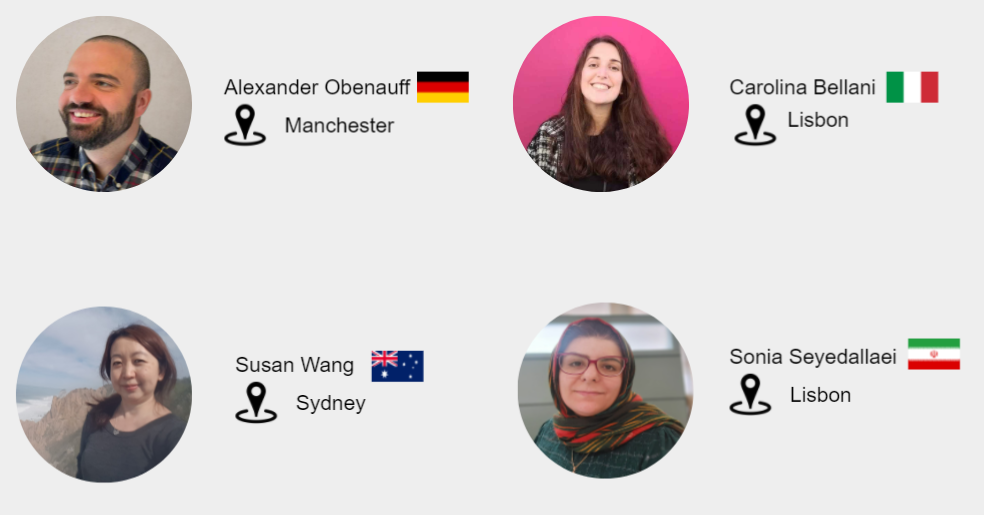

## External links and resources
Paste here all the links to external resources that are necessary to understand and run your code. Add descriptions to make it clear how to use them during evaluation.

**Note** we hide the cells of the code and we create chapters. On the left, there is the possibility to see the table of contents, in the case you would like to skip between an analysis and the other.

We hope you are able to see the notebook formatted and already run, with visualization rendered. In the case you don't see them, please go to **our notebook in the link**: [our notebook](https://drive.google.com/file/d/1Rh-OxeNyvKJd-40gAKuU32oCglVuPy5G/view?usp=sharing)


## Introduction
Describe how you framed the challenge by telling us what problem are you trying to solve and how your solution solves that problem.

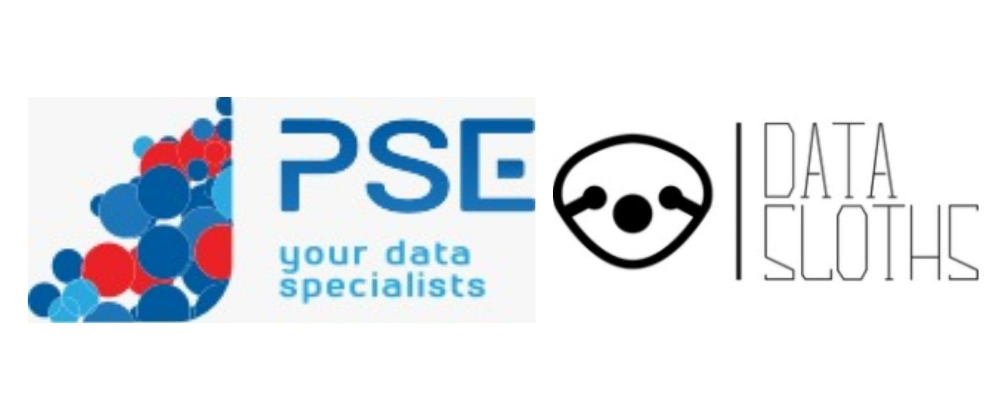

### Optimisation of the Outdoor Advertising within Cities considering Environment and Sustainability

**Challenge Provider:** PSE

**Outcome:** Create a model that optimises the number and location of the outdoor advertising
positions in order to minimize the visual impact in urban environments. Consider also a
better dimensioning and integration of outdoor advertising positions in cities.

**Data:** Outdoor Panel Dataset - this dataset provides a list of outdoor advertisements in the entire territory of mainland
Portugal with the number of average views and its maximum visibility.

**Tips:**
- In addition, mobility data can be studied and integrated in order to understand
places with high potential and lack of outdoor panels (see data from previous PSE
challenge);
- Other open datasets might be crucial to solving this challenge;
- Don’t forget to check the state of the art;
- If possible, don’t forget to explain the outcome of your model.


**Do you feel a bit overwhelmed ?**

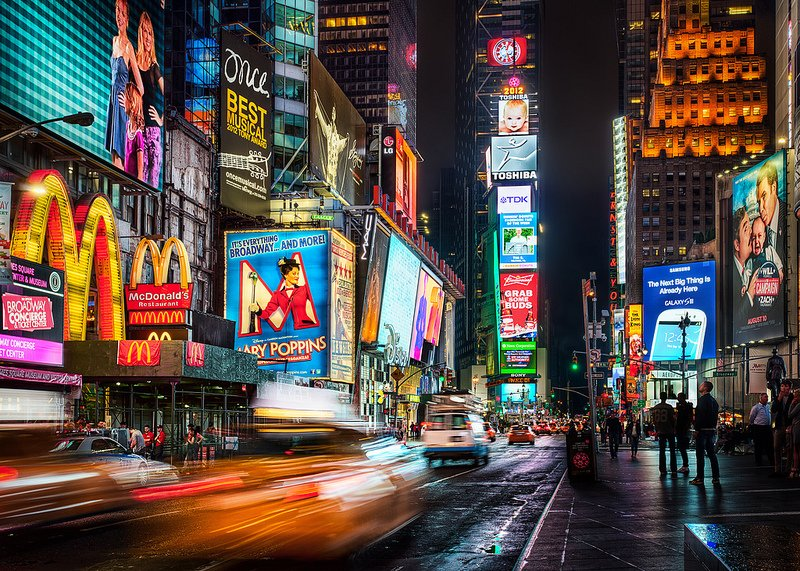

Source [Advertisment at Time Square](https://www.6sqft.com/pepsodent-camel-and-yashica-ads-and-architecture-in-old-times-square/)


Advertisment panels are part of visual pollution. "Visual pollution is an aesthetic issue and refers to the impacts of pollution that impair one's ability to enjoy a pleasant view. Visual pollution disturbs the visual areas of people by creating harmful changes in the natural environment." [Visual Pollution](http://www.pollutionissues.com/Ve-Z/Visual-Pollution.html). Large advertisment panels in Time Square New York became more of tourist attraction rather than problem of visual pollution, but in many places they are the driving element of visual pollution. In many cities outdoor advertisment mean high revenue income for the city but they not just spoil the cities views and appearance if they overtake every bus stop and street. Outdoor advertisment can also deepen inequality [How outdoor advertising can deepen inequality](https://www.bbc.com/worklife/article/20200817-the-inequality-of-outdoor-advertising-exposure) or expose rish to driver [A field study on the effects of digital billboards on glance behavior during highway driving](https://www.researchgate.net/publication/288931602_A_field_study_on_the_effects_of_digital_billboards_on_glance_behavior_during_highway_driving)

### Executive summary

We start by loading the following datasets - panel dataset, mobility data, and the shape file containing Portugal parish information, and perform detailed exploratory analysis (EDA) for each.
* 81% of the panels have the same value for the maximum visibility: 69 m
* We have a median value of 5923 for the number of average daily views and 75% of the panels have less than 9621 average daily views

We then extract "dicofre" zone for each panel id using the shape file and create dataframes that aggregate panel information at Dicofre level. This allowed us to do further exploratory analysis, including identifying “dicofre” zones (and Parishes) that had the most number of advertising panels.

* From geolocation analysis, we see that the interior of Portugal doesn’t have advertisements, that instead are concentrated in the main cities, such as Porto and Lisbon. In particular, 75% of the “dicofre” zones have less than 60 panels in total. Alvalade in the district of Lisbon has a huge number of advertisements, 694 panels, followed by Avenidas Novas (Lisbon, 635 panels) and Matosinhos (Porto, 579)

Separately, we also used Geo-spatial clustering to identify regions based on proximity of panel locations.

**Modeling**
We explored different solutions with increasing complexity. We used animation to illustrate the panel selection process, as we believe it would communicate the solution more effectively to a broader audience. 

**Proposal 1)**
For our simplest model, we investigated the effect of removing panels on the total average daily view per “dicofre”, by using a method that retain panels based on daily view, and found that this met the objective of optimising the advertising reach while minimising the viewership. A line plot showed that 56.7% of panels produced 80.6% of total views, and 71.4% of panels produced 90.4% of total views. We used geolocation animation to show which panels get removed as the threshold for total viewership changes from 100% down to 10%.

**Proposal 2)**
Our second model aimed to spread out the location of panels in each “dicofre”, by identifying the top panels and use the proximity of surrounding panels and their maximum value of daily views to decide which panels to keep.

**Proposal 3)**
Finally, we found that Genetic Algorithm provides an elegant way to solve this problem, as it provides a great level of controls in designing what criteria to optimize for, by creating customised "fitness function", and selecting the number of iterations and other parameters. We can experiment with the model until we are happy with the results.

**Our impact/how we measured the visual impact)**
We considered the number of panels, their densities and also the max visibility in meters. For example in the proposal 3, we reduced these three factors together (while maximizing the daily views), therefore we improve the visual environment of cities and the sustainability of the outdoor advertising activity.



## Development
Start coding here! 👩‍💻

Don't hesitate to create markdown cells to include descriptions of your work where you see fit, as well as commenting your code.

We know that you know exactly where to start when it comes to crunching data and building models, but don't forget that WDL is all about social impact...so take that into consideration as well.

To keep the notebook readable, we decided to divide the **Development** in the following sections:
- Load and Import Packages
- Load the data
- EDA
- Model

### Load and Import Packages

In [1]:
!pip install geopandas

     |████████████████████████████████| 1.0MB 25.3MB/s 
     |████████████████████████████████| 6.6MB 28.6MB/s 
     |████████████████████████████████| 15.3MB 262kB/s 


In [2]:
pip install plotly==4.14.3

     |████████████████████████████████| 13.2MB 152kB/s 
  Found existing installation: plotly 4.4.1
    Uninstalling plotly-4.4.1:
      Successfully uninstalled plotly-4.4.1


In [3]:
!pip install turfpy

  Created wheel for turfpy: filename=turfpy-0.0.6-cp37-none-any.whl size=38014 sha256=50f93d9e8f4f567ed63b341da253787510859003d137550eda70454ab79d7927
  Stored in directory: /root/.cache/pip/wheels/ee/ad/15/8ea588aef067161ed99d618b95d297325b3b4339694aaedc97
Successfully built turfpy


In [4]:
!pip install scipy==1.6.3

     |████████████████████████████████| 27.4MB 145kB/s 
ERROR: albumentations 0.1.12 has requirement imgaug<0.2.7,>=0.2.5, but you'll have imgaug 0.2.9 which is incompatible.
  Found existing installation: scipy 1.4.1
    Uninstalling scipy-1.4.1:
      Successfully uninstalled scipy-1.4.1


In [5]:
import pandas as pd
from urllib.request import urlopen
from zipfile import ZipFile
from io import BytesIO
import plotly.express as px
import geopandas as gpd
from turfpy.measurement import boolean_point_in_polygon
from geojson import Point, Polygon, Feature
import json
import numpy as np
from itertools import combinations
from shapely.geometry import Point
from shapely.geometry.polygon import Polygon
import time
import matplotlib.pyplot as plt
from sklearn import preprocessing, cluster
import scipy
import multiprocessing as mp
from sklearn.metrics import pairwise_distances
from sklearn.preprocessing import StandardScaler
from sklearn.preprocessing import MinMaxScaler
from math import sin, cos, sqrt, atan2, radians
from sklearn.metrics.pairwise import haversine_distances
from scipy.cluster.vq import vq
from random import randint, random
from copy import deepcopy


### Load Data

#### Data Dictionary

In [6]:
#@title
pd.read_excel("https://wdl-data.fra1.digitaloceanspaces.com/pse/OutdoorAd_dictionary.xlsx", header=1)

,Column Name,Description,Type,Example
0,PanelID,Panel Identifier,Integer,176.000
1,X,Longitude,Real,-9.431
2,Y,Latitude,Real,38.710
3,Max_Visibility_Distance,Maximum visibility [m],Real,71.000
4,Average_Daily_Views,Average number of daily views for each panel,Real,30.000


#### Outdoor inventory zip files

In [7]:
#@title
resp = urlopen("https://wdl-data.fra1.digitaloceanspaces.com/pse/outdoor_inventory.zip")
zipfile = ZipFile(BytesIO(resp.read()))
#zipfile.namelist()
zipfile = "https://wdl-data.fra1.digitaloceanspaces.com/pse/outdoor_inventory.zip"
df_advert_panels= gpd.read_file(zipfile)
df_advert_panels.info()
df_advert_panels = gpd.GeoDataFrame(df_advert_panels, geometry=gpd.points_from_xy(df_advert_panels.X, df_advert_panels.Y))
df_advert_panels['X'] = df_advert_panels.geometry.x
df_advert_panels['Y'] = df_advert_panels.geometry.y
df_advert_panels.head()

<class 'geopandas.geodataframe.GeoDataFrame'>
RangeIndex: 30375 entries, 0 to 30374
Data columns (total 6 columns):
 #   Column      Non-Null Count  Dtype   
---  ------      --------------  -----   
 0   PanelID     30375 non-null  int64   
 1   X           30375 non-null  float64 
 2   Y           30375 non-null  float64 
 3   Max_Visibi  30375 non-null  int64   
 4   Average_Da  30375 non-null  float64 
 5   geometry    30375 non-null  geometry
dtypes: float64(3), geometry(1), int64(2)
memory usage: 1.4 MB


,PanelID,X,Y,Max_Visibi,Average_Da,geometry
0,26144,-8.473975,40.900768,69,31.0,POINT (-8.47397 40.90077)
1,11714,-9.315949,38.958125,69,31.0,POINT (-9.31595 38.95813)
2,26109,-8.510079,40.871821,69,32.0,POINT (-8.51008 40.87182)
3,32555,-8.479751,40.837695,69,32.0,POINT (-8.47975 40.83769)
4,5291,-8.429870,40.268692,69,32.0,POINT (-8.42987 40.26869)


We have **30 375 panels** and their information.

#### Mobility data (as the tip suggests)

Mobility will be useful to to understand places with high potential and lack of outdoor panels.

In [8]:
#@title
#load mobility data
url_mobility = "https://wdl-data.fra1.digitaloceanspaces.com/pse/Hourly%20Avarege%20Traffic_AMP_AML"
df_mobility = pd.read_csv(url_mobility, delimiter="|")
df_mobility.info()
df_mobility.head()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 6290 entries, 0 to 6289
Data columns (total 3 columns):
 #   Column                  Non-Null Count  Dtype  
---  ------                  --------------  -----  
 0   Dicofre                 6290 non-null   int64  
 1   HOUR                    6290 non-null   int64  
 2   Hourly Average Traffic  6290 non-null   float64
dtypes: float64(1), int64(2)
memory usage: 147.5 KB


,Dicofre,HOUR,Hourly Average Traffic
0,10402,8,220.821534
1,10402,9,220.821534
2,10402,13,241.969685
3,10402,14,263.117835
4,10402,15,263.117835


For each Dicrofree code (Distrito-Concelho-Freguesia code of Portugal) we have the average traffic by hours.

**Obs. from challenge support channel in Discord.** The data refer to the period between April 2019 and March 2020

#### Shape file

In [9]:
#@title
#load shapefiles
df_dicofre = gpd.read_file('http://mapas.dgterritorio.pt/ATOM-download/CAOP-Cont/Cont_AAD_CAOP2020.zip')
df_dicofre.to_crs("EPSG:4326", inplace=True) #important to show in the map
df_dicofre.info()
display(df_dicofre.head())

<class 'geopandas.geodataframe.GeoDataFrame'>
RangeIndex: 3223 entries, 0 to 3222
Data columns (total 9 columns):
 #   Column      Non-Null Count  Dtype   
---  ------      --------------  -----   
 0   Dicofre     3223 non-null   object  
 1   Freguesia   3223 non-null   object  
 2   Concelho    3223 non-null   object  
 3   Distrito    3223 non-null   object  
 4   TAA         3223 non-null   object  
 5   Area_T_ha   3223 non-null   float64 
 6   Area_EA_ha  3223 non-null   float64 
 7   Des_Simpli  3223 non-null   object  
 8   geometry    3223 non-null   geometry
dtypes: float64(2), geometry(1), object(6)
memory usage: 226.7+ KB


,Dicofre,Freguesia,Concelho,Distrito,TAA,Area_T_ha,Area_EA_ha,Des_Simpli,geometry
0,081504,Sagres,Vila do Bispo,Faro,ÁREA SECUNDÁRIA,3436.91,0.04,Sagres,"POLYGON ((-8.91601 37.01461, -8.91608 37.01459..."
1,081504,Sagres,Vila do Bispo,Faro,ÁREA SECUNDÁRIA,3436.91,0.17,Sagres,"POLYGON ((-8.91569 37.01493, -8.91582 37.01490..."
2,081504,Sagres,Vila do Bispo,Faro,ÁREA SECUNDÁRIA,3436.91,0.20,Sagres,"POLYGON ((-8.91653 37.01563, -8.91648 37.01558..."
3,081504,Sagres,Vila do Bispo,Faro,ÁREA SECUNDÁRIA,3436.91,0.09,Sagres,"POLYGON ((-8.92004 37.01578, -8.92015 37.01576..."
4,081504,Sagres,Vila do Bispo,Faro,ÁREA SECUNDÁRIA,3436.91,0.39,Sagres,"POLYGON ((-8.91743 37.01611, -8.91740 37.01609..."


### EDA 01: Advertising Data

#### Check the data

In [10]:
#@title
print("We have ",df_advert_panels.PanelID.nunique(),"unique panelsID")
print("Here some example of different panels in the same location: ")
#Checking the duplicate by location
df_advert_panels[df_advert_panels.duplicated(subset=['X','Y'],keep=False)].sort_values(by=['X'])

We have  30375 unique panelsID
Here some example of different panels in the same location: 


,PanelID,X,Y,Max_Visibi,Average_Da,geometry
8219,27310,-9.460951,38.788801,69,3442.0,POINT (-9.46095 38.78880)
13476,27311,-9.460951,38.788801,69,5295.0,POINT (-9.46095 38.78880)
1768,27289,-9.456441,38.802505,69,868.0,POINT (-9.45644 38.80250)
1445,27288,-9.456441,38.802505,69,703.0,POINT (-9.45644 38.80250)
1823,27556,-9.437526,38.800199,69,896.0,POINT (-9.43753 38.80020)
...,...,...,...,...,...,...
28692,20890,-7.451336,37.182106,75,17731.0,POINT (-7.45134 37.18211)
22482,20882,-7.448825,37.179311,75,9449.0,POINT (-7.44883 37.17931)
22489,20881,-7.448825,37.179311,75,9453.0,POINT (-7.44883 37.17931)
25348,20884,-7.448797,37.179308,75,11745.0,POINT (-7.44880 37.17931)


**Obs from challenge support channel in Discord.** It happens because in many positions there are two sides of the same "foot". For example, in a position near a road, there may be a panel on the side in favor of the traffic and a panel on the side opposite to the traffic. The position is the same but has two panels.

#### Distribution of maximum visibility

In [11]:
#@title
fig = px.histogram(df_advert_panels, x="Max_Visibi", category_orders={"Max_Visibi": sorted(list(df_advert_panels['Max_Visibi'].unique()))})
fig.update_xaxes(type='category', title="Maximum visibility [m]")
fig.update_layout(title="Distribution of maximum visibility [m] - Count")
fig.show()

df_advert_panels['Max_Visibi'].describe()

count    30375.000000
mean        77.181267
std         22.593576
min         61.000000
25%         69.000000
50%         69.000000
75%         69.000000
max        180.000000
Name: Max_Visibi, dtype: float64

#### Create bins for maximum visibility and check distribution

We decided to create bins that represents the popular visibilty values individually, such as 69 and 89, while grouping less popular values between them.

In [12]:
#@title
df_advert_panels["max_vis_bins"] = pd.cut(df_advert_panels["Max_Visibi"],
       [0, 63, 69, 88, 89, 141, 145, 180], labels=["<69", "69", "71-88", "89", "91-141", "145", ">145"]) 

In [13]:
#@title
fig = px.histogram(df_advert_panels, x="max_vis_bins", category_orders={"max_vis_bins": ['<69', '69', '71-88', '89', '91-141', '145', '>145']})
fig.update_xaxes(type='category', title="max_vis_bins")
fig.update_layout(width=800, height=400, title_x=0.2, title_text="Distribution of max_vis_bins - Count")
fig.show()


In [14]:
#@title
print("Percentage of panels with max visibility in meters == 69: ")
100*(len(df_advert_panels[df_advert_panels["Max_Visibi"]==69]) / len(df_advert_panels))

Percentage of panels with max visibility in meters == 69: 


81.16213991769547

The figure above indicates that almost 25k (81.2%) of the ads has the maximum viewing distance of 69 meters.

#### Distribution of average number of daily views

In [15]:
#@title
fig = px.histogram(df_advert_panels, x="Average_Da")
fig.update_xaxes(title="number of average daily views")
fig.update_yaxes(title="count")
fig.update_layout(title_x=0.3, title_text="Histogram of average panel daily views")
fig.show()

df_advert_panels['Average_Da'].describe()

count    30375.000000
mean      7302.318656
std       6112.093208
min         31.000000
25%       3221.000000
50%       5923.000000
75%       9621.000000
max      81532.000000
Name: Average_Da, dtype: float64

#### Create quantile bins for average daily views

In [16]:
#@title
df_advert_panels["avg_daily_views_bins"] = pd.qcut(df_advert_panels["Average_Da"], 4, 
                                                   labels=["25%", "50%", "75%", "100%"]) 

fig = px.histogram(df_advert_panels, x="avg_daily_views_bins")#, category_orders={"avg_daily_views_bins": ['<69', '69', '71-88', '89', '91-141', '145', '>145']})
fig.update_xaxes(type='category', title="avg_daily_views_bins")
fig.update_layout(width=600, height=300, title_x=0.2, title_text="Distribution of avg_daily_views_bins - Count")
fig.show()

#### Relation between maximum visibility and avg number of daily views

In [17]:
#@title
fig = px.box(x=df_advert_panels.sort_values(by=['Max_Visibi']).Max_Visibi, y=df_advert_panels.sort_values(by=['Max_Visibi']).Average_Da, points="all")
fig.update_xaxes(type='category', title="Maximum visibility [m]")
fig.update_yaxes(title="Average number of daily views for each panel")
fig.update_layout(title="Is there a relation between maximum visibility and avg number of daily views?")
fig.show()

#### Does max visibility correlate with the panel size?

As we panel size is not avaiable in the dataset we made the assumption that higher visibilitmean also larger panel size. We have checked a couple of panel locations for different max visibility and can conclude that panel size is larger for higher visibility.

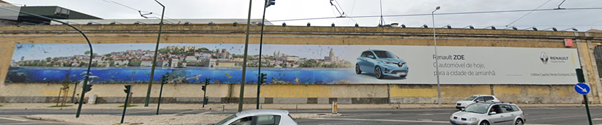

Max visibility 180 at Av. da India Lisbon, Source: Google Street View 2021

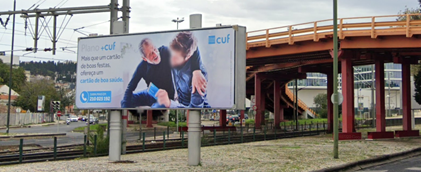

Max visibility 145 at Av. Brasília Lisbon, Source: Google Street View 2021

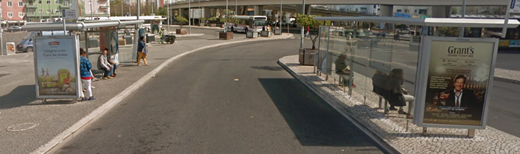

Max visibility 69 at Algés, Lisbon, Source: Google Street View 2021

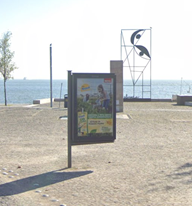

Max visibility 69 at Av. Ribeira das Naus, Source: Google Street View 2021

#### Geolocation maps

In [18]:
#@title
print("Location of panels ID - color: average daily views")
#fig = px.scatter_mapbox(df_advert_panels, lat="Y", lon="X", center={'lon':-8.473975,'lat':39.900768},zoom=6, text='PanelID',color="Average_Da",color_continuous_scale=px.colors.sequential.Bluered, size="Max_Visibi", width=700, height=800)
fig = px.scatter_mapbox(df_advert_panels, lat="Y", lon="X", width=700, height=800,center={'lon':-8.473975,'lat':39.900768},zoom=6,color="avg_daily_views_bins")#, hover_data='PanelID' )#,size="Max_Visibi")
fig.update_layout(mapbox_style="carto-positron")
fig.update_layout(margin={"r":0,"t":0,"l":0,"b":0})
fig.show()

Location of panels ID - color: average daily views


In [19]:
#@title
print("Location of panels ID - color: max visibility")
fig = px.scatter_mapbox(df_advert_panels, lat="Y", lon="X", width=700, height=800,center={'lon':-8.473975,'lat':39.900768},zoom=6,color="Max_Visibi")#,hover_data='PanelID')#,size="Max_Visibi")
fig.update_layout(mapbox_style="carto-positron")
fig.update_layout(margin={"r":0,"t":0,"l":0,"b":0})
fig.show()

Location of panels ID - color: max visibility


### EDA 02: Mobility Data

In [20]:
#@title
print("Uniques: ")
df_mobility.nunique()

Uniques: 


Dicofre                    291
HOUR                        24
Hourly Average Traffic    6279
dtype: int64

### EDA 03: Shape file

In [21]:
#@title
print("uniques: ")
df_dicofre.nunique()

uniques: 


Dicofre       2882
Freguesia     2706
Concelho       278
Distrito        18
TAA              2
Area_T_ha     2869
Area_EA_ha    2921
Des_Simpli    2706
geometry      3223
dtype: int64

In [22]:
#@title
print("there are district with different concelhos but the same name of  freguesia")
display(df_dicofre.Freguesia.value_counts())
display(df_dicofre.loc[df_dicofre.Freguesia =='Pinheiro',:])

there are district with different concelhos but the same name of  freguesia


Aljezur                                                                   60
Bordeira                                                                  38
Albufeira e Olhos de Água                                                 34
São Gonçalo de Lagos                                                      34
Alcabideche                                                               34
                                                                          ..
União das freguesias de Monfortinho e Salvaterra do Extremo                1
Beijós                                                                     1
Maçãs de Dona Maria                                                        1
União das freguesias de Atães e Rendufe                                    1
União das freguesias de Amoreira da Gândara, Paredes do Bairro e Ancas     1
Name: Freguesia, Length: 2706, dtype: int64

,Dicofre,Freguesia,Concelho,Distrito,TAA,Area_T_ha,Area_EA_ha,Des_Simpli,geometry
223,180319,Pinheiro,Castro Daire,Viseu,ÁREA PRINCIPAL,1959.57,1959.57,Pinheiro,"POLYGON ((-7.97036 40.97217, -7.97008 40.97172..."
1749,030836,Pinheiro,Guimarães,Braga,ÁREA PRINCIPAL,193.27,193.27,Pinheiro,"POLYGON ((-8.27748 41.42272, -8.27747 41.42267..."
1892,181005,Pinheiro,Oliveira de Frades,Viseu,ÁREA PRINCIPAL,2161.86,2161.86,Pinheiro,"POLYGON ((-8.19708 40.69694, -8.19954 40.69664..."
1957,090110,Pinheiro,Aguiar da Beira,Guarda,ÁREA PRINCIPAL,1588.32,1588.32,Pinheiro,"POLYGON ((-7.57666 40.77772, -7.57668 40.77771..."
2497,130314,Pinheiro,Felgueiras,Porto,ÁREA PRINCIPAL,357.44,357.44,Pinheiro,"POLYGON ((-8.14489 41.37769, -8.14486 41.37756..."
2894,031112,Pinheiro,Vieira do Minho,Braga,ÁREA PRINCIPAL,1026.63,1026.63,Pinheiro,"POLYGON ((-8.06896 41.64606, -8.07105 41.64516..."


#### Merge mobility data with shape file

In [23]:
#@title
aggcol = 'Hourly Average Traffic'
df_mobility_gb = df_mobility.groupby('Dicofre')[[aggcol]].sum().reset_index()
df_mobility_gb['Dicofre']=df_mobility_gb['Dicofre'].apply(lambda x: str(x)) # to do the merge with the df_dicofre
print("sum the traffic by freguesia to get the daily traffic")
display(df_mobility_gb.head())

df_mobilitygb_dicofre = pd.merge(df_mobility_gb,df_dicofre,how='left',on='Dicofre')
print("Merge: consider only the freguesia with traffic")
display(df_mobilitygb_dicofre.tail())
df_mobilitygb_dicofre.info()

sum the traffic by freguesia to get the daily traffic


,Dicofre,Hourly Average Traffic
0,10402,1209.848423
1,10407,173.348655
2,10409,155.666902
3,10411,78.548967
4,10413,79.351242


Merge: consider only the freguesia with traffic


,Dicofre,Hourly Average Traffic,Freguesia,Concelho,Distrito,TAA,Area_T_ha,Area_EA_ha,Des_Simpli,geometry
351,151208,947.229999,Sado,Setúbal,Setúbal,ÁREA PRINCIPAL,6548.87,6548.87,Sado,"POLYGON ((-8.75359 38.53507, -8.74990 38.52807..."
352,151209,9068.000556,União das freguesias de Azeitão (São Lourenço ...,Setúbal,Setúbal,ÁREA SECUNDÁRIA,6932.25,0.03,Azeitão (São Lourenço e São Simão),"POLYGON ((-8.99510 38.46199, -8.99511 38.46199..."
353,151209,9068.000556,União das freguesias de Azeitão (São Lourenço ...,Setúbal,Setúbal,ÁREA SECUNDÁRIA,6932.25,0.69,Azeitão (São Lourenço e São Simão),"POLYGON ((-8.97205 38.47827, -8.97198 38.47825..."
354,151209,9068.000556,União das freguesias de Azeitão (São Lourenço ...,Setúbal,Setúbal,ÁREA PRINCIPAL,6932.25,6931.54,Azeitão (São Lourenço e São Simão),"POLYGON ((-9.02585 38.57828, -9.02591 38.57810..."
355,151210,7068.622055,"União das freguesias de Setúbal (São Julião, N...",Setúbal,Setúbal,ÁREA PRINCIPAL,3676.53,3676.53,"S. Julião, N. S. da Anunciada e S. Maria da Graça","POLYGON ((-8.88902 38.50265, -8.89179 38.50377..."


<class 'pandas.core.frame.DataFrame'>
Int64Index: 356 entries, 0 to 355
Data columns (total 10 columns):
 #   Column                  Non-Null Count  Dtype   
---  ------                  --------------  -----   
 0   Dicofre                 356 non-null    object  
 1   Hourly Average Traffic  356 non-null    float64 
 2   Freguesia               295 non-null    object  
 3   Concelho                295 non-null    object  
 4   Distrito                295 non-null    object  
 5   TAA                     295 non-null    object  
 6   Area_T_ha               295 non-null    float64 
 7   Area_EA_ha              295 non-null    float64 
 8   Des_Simpli              295 non-null    object  
 9   geometry                295 non-null    geometry
dtypes: float64(3), geometry(1), object(6)
memory usage: 30.6+ KB


### EDA 04: Lisbon advert panels and daily average traffic sum

In [24]:
#@title
#Lisbon
df_mobility_gb_dicofre_Lisb = df_mobilitygb_dicofre[df_mobilitygb_dicofre.Distrito=='Lisboa']
df_dicofre_Lisb = df_dicofre[df_dicofre.Distrito=='Lisboa']


# only Lisbon, value absolutes
print("Lisbon - Advert Panels")
dis = 'Dicofre'
fig = px.choropleth_mapbox(df_mobility_gb_dicofre_Lisb, geojson=df_dicofre_Lisb, color=aggcol,
                           locations=dis, featureidkey="properties.{}".format(dis),
                           color_continuous_scale="Greens",
                           mapbox_style="carto-positron",
                           zoom=10, center = {"lat": 38.73, "lon": -9.14},
                           opacity=0.5
                          )

fig2 = px.scatter_mapbox(df_advert_panels, lat="Y", lon="X",opacity=0.07,color_discrete_sequence=['darkblue'])

fig.add_trace(fig2.data[0])
for i, frame in enumerate(fig.frames):
    fig.frames[i].data += (fig2.frames[i].data[0],)

fig.update_layout(margin={"r":0,"t":0,"l":0,"b":0})
fig.update_layout(title="Lisbon - Advert Panels")
fig.show()

Lisbon - Advert Panels


It seems to be a general correlation with traffic and panels location except for the historical centre of Lisbon, where there is no traffic but high density of panels.

### DATA PREPARATION: From ads location (long and lat) to dicofre code

In [25]:
#@title
#create dictionary for dicofre and geometric objects
freg_poly_dict=dict(zip(df_dicofre.Dicofre, df_dicofre.geometry))
first_x = df_advert_panels.shape[0]
dicofr_ls = []

df_advert_panels_points = df_advert_panels['geometry'].iloc[:first_x]

for point in df_advert_panels_points:
  start_time = time.time()
  #print(point)

  dicofre_point="" #if we don't find the polygon of the points, it will be ""

  for dicofr, polygon in freg_poly_dict.items():
    #print(polygon)

    if polygon.contains(point):

      dicofre_point=dicofr  
      break

    else:
      pass

  dicofr_ls.append(dicofr) 
  end_time = time.time()

df_advert_panels_sub=df_advert_panels.iloc[:first_x]
df_advert_panels_sub['dicofre']=dicofr_ls

print("total time for one loop: ", end_time - start_time)

total time for one loop:  0.0076596736907958984


/usr/local/lib/python3.7/dist-packages/geopandas/geodataframe.py:1322: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



Add Frequesia info into combined file

In [26]:
#@title
# drop duplicates from df_dicofre
df_dicofre_no_dup = df_dicofre.drop_duplicates(subset=['Dicofre'])
df_advert_panels_sub1 = pd.merge(df_advert_panels_sub.sort_values(by="PanelID"), df_dicofre_no_dup[["Dicofre",'Freguesia', 'Concelho', 'Distrito']],left_on='dicofre', right_on="Dicofre", how="inner")

df_advert_panels_sub1 = df_advert_panels_sub1.rename(columns={"Freguesia" : "freguesia", "Concelho" : "concelho", "Distrito" : "distrito"})
df_advert_panels_sub1 = df_advert_panels_sub1[['PanelID', 'dicofre', 'freguesia', 'concelho', 'distrito', 'X', 'Y', 'Max_Visibi', 'Average_Da', 'geometry',
       'max_vis_bins', 'avg_daily_views_bins']]
       
df_advert_panels_sub1.head()
df_advert_panels_sub = df_advert_panels_sub1

### EDA 05: Creating combined dataframe at Dicofre level and further EDA

In this section we are interested in analysing information at a **dicofre (parish**) level. 

Utlimately, we want to find the top 3 panels per parish, based on the panel's combined maximum viewing distance and its average daily view.

We start by creating a new feature, **max_vis_views**, to represent that.

Then we create a parish-level dataframe, that aggregates key panel information, such as total panel counts, panel count per binned viewing distance and binned average daily view.

We also calculated the mean panel stats for each parish, such as the min, max, median, mean and total for both average total daily view, and maximum viewing distance.

Finally we identified the top 3 panel ids with the maximum combined viewing distance and daily view per parish, using the new feature **max_vis_views**, and visualise them in a Geolocation map.



In [27]:
# @title
df_advert_panels_sub["max_vis_views"] = df_advert_panels_sub["Max_Visibi"] * df_advert_panels_sub["Average_Da"]
fig = px.histogram(df_advert_panels_sub, x="max_vis_views")
fig.update_layout( width=800, height=400,title_x = 0.1, title_text=f"Histogram of max_vis_view - (Max Visibility * Average Daily View)")
fig.show()

#### Create dataframe at parish level to aggregate key stats

In [28]:
#@title
df_dico_panel_vis0 = df_advert_panels_sub[["dicofre", "max_vis_bins", "PanelID"]].pivot_table(
    index='dicofre', # the rows (turned into index)
    columns='max_vis_bins', # the column values
    #values='Max_Visibi', # the field(s) to processed in each group
    aggfunc="count", # group operation
    fill_value = 0
)
df_dico_panel_vis0.columns = df_dico_panel_vis0.columns.droplevel().tolist()
df_dico_panel_vis0.reset_index(inplace=True)

df_dico_panel_views0 = df_advert_panels_sub[["dicofre", "avg_daily_views_bins", "PanelID"]].pivot_table(
    index='dicofre', # the rows (turned into index)
    columns='avg_daily_views_bins', # the column values
    #values='Max_Visibi', # the field(s) to processed in each group
    aggfunc="count", # group operation
    fill_value = 0
)

df_dico_panel_views0.columns = df_dico_panel_views0.columns.droplevel().tolist()
df_dico_panel_views0.reset_index(inplace=True)
df_dico_combined = df_dico_panel_vis0.merge(df_dico_panel_views0, on="dicofre")

In [29]:
#@title
df_advert_panels_sub1 = df_advert_panels_sub.set_index("PanelID")
adverts_groupedby_dicofre = df_advert_panels_sub1.groupby(["dicofre"])
df_dico_pan_counts = adverts_groupedby_dicofre.size().reset_index(name='panel_counts')
df_dico_combined = df_dico_pan_counts.merge(df_dico_combined, on="dicofre")

adverts_groupedby_dicofre1 = adverts_groupedby_dicofre.agg({"Max_Visibi": [np.min, np.max, np.mean, np.median, np.sum]})
adverts_groupedby_dicofre1.columns = adverts_groupedby_dicofre1.columns.droplevel()
adverts_groupedby_dicofre1 = adverts_groupedby_dicofre1.rename(columns={'amin':'vis_min', 'amax':'vis_max', 'mean':'vis_mean', 'median':'vis_median', 'sum':'vis_sum'})

adverts_groupedby_dicofre2 = adverts_groupedby_dicofre.agg({"Average_Da": [np.min, np.max, np.mean, np.median, np.sum]})
adverts_groupedby_dicofre2.columns = adverts_groupedby_dicofre2.columns.droplevel()
adverts_groupedby_dicofre2 = adverts_groupedby_dicofre2.rename(columns={'amin':'day_view_min', 'amax':'day_view_max', 'mean':'day_view_mean', 'median':'day_view_median', 'sum':'day_view_sum'})

adverts_groupedby_dicofre3 = adverts_groupedby_dicofre.agg({"max_vis_views": [np.min, np.max, np.mean, np.median, np.sum]})
adverts_groupedby_dicofre3.columns = adverts_groupedby_dicofre3.columns.droplevel()
adverts_groupedby_dicofre3 = adverts_groupedby_dicofre3.rename(columns={'amin':'max_vis_view_min', 'amax':'max_vis_view_max', 'mean':'max_vis_view_mean', 'median':'max_vis_view_median', 'sum':'max_vis_view_sum'})

df_dico_combined = df_dico_combined.merge(adverts_groupedby_dicofre1.reset_index(), on="dicofre")
df_dico_combined = df_dico_combined.merge(adverts_groupedby_dicofre2.reset_index(), on="dicofre")
df_dico_combined = df_dico_combined.merge(adverts_groupedby_dicofre3.reset_index(), on="dicofre")
df_dico_combined = df_dico_combined.set_index("dicofre")
df_dico_combined


,panel_counts,<69,69,71-88,89,91-141,145,>145,25%,50%,75%,100%,vis_min,vis_max,vis_mean,vis_median,vis_sum,day_view_min,day_view_max,day_view_mean,day_view_median,day_view_sum,max_vis_view_min,max_vis_view_max,max_vis_view_mean,max_vis_view_median,max_vis_view_sum
dicofre,,,,,,,,,,,,,,,,,,,,,,,,,,,
010103,6,0,6,0,0,0,0,0,6,0,0,0,69,69,69.000000,69.0,414,146.0,507.0,292.000000,237.0,1752.0,10074.0,34983.0,2.014800e+04,16353.0,120888.0
010119,4,0,4,0,0,0,0,0,1,3,0,0,69,69,69.000000,69.0,276,2161.0,3758.0,3306.750000,3654.0,13227.0,149109.0,259302.0,2.281658e+05,252126.0,912663.0
010121,49,0,32,6,5,0,6,0,11,4,5,29,69,145,81.448980,69.0,3991,253.0,35681.0,11987.000000,12456.0,587363.0,22517.0,5173745.0,1.072854e+06,951990.0,52569828.0
010122,2,0,0,2,0,0,0,0,0,0,0,2,88,88,88.000000,88.0,176,32124.0,33147.0,32635.500000,32635.5,65271.0,2826912.0,2916936.0,2.871924e+06,2871924.0,5743848.0
010124,3,0,3,0,0,0,0,0,0,0,0,3,69,69,69.000000,69.0,207,10563.0,12881.0,11457.666667,10929.0,34373.0,728847.0,888789.0,7.905790e+05,754101.0,2371737.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
182321,13,0,7,4,1,0,1,0,11,1,0,1,69,145,78.230769,69.0,1017,56.0,20189.0,2526.076923,796.0,32839.0,3864.0,2927405.0,2.985412e+05,54924.0,3881035.0
182323,7,0,6,1,0,0,0,0,7,0,0,0,69,88,71.714286,69.0,502,38.0,2937.0,1060.857143,52.0,7426.0,2622.0,258456.0,8.117100e+04,3588.0,568197.0
182339,5,0,5,0,0,0,0,0,2,2,1,0,69,69,69.000000,69.0,345,634.0,6401.0,4036.400000,4196.0,20182.0,43746.0,441669.0,2.785116e+05,289524.0,1392558.0


In [30]:
#@title
df_dicofre1 = pd.DataFrame(adverts_groupedby_dicofre['max_vis_views'].nlargest(3))
df_dicofre1

max_vis_views
dicofre PanelID               
010103  45202          34983.0
        45201          32568.0
        1148           20700.0
010119  1142          259302.0
        1140          257163.0
...                        ...
182341  29908         960045.0
        20810         701937.0
        20692         626400.0
182403  49302         109208.0
        49303          22000.0

[1469 rows x 1 columns]

In [31]:
#@title
df_dicofre1['idx'] = df_dicofre1.groupby('dicofre').cumcount()
df_dicofre1['vis_panel_idx'] = 'vis_panel_' + df_dicofre1.idx.astype(str)
df_dicofre1['max_vis_views_idx'] = 'max_vis_views_' + df_dicofre1.idx.astype(str)
panel = df_dicofre1.reset_index().pivot(index='dicofre',columns='vis_panel_idx',values='PanelID')
max_vis_views = df_dicofre1.reset_index().pivot(index='dicofre',columns='max_vis_views_idx',values='max_vis_views')
df_max_vis_views = pd.concat([panel,max_vis_views],axis=1)
df_max_vis_views.reset_index(inplace=True)
#df_max_vis_views.head(3)
df_dico_combined = df_dico_combined.merge(df_max_vis_views, on="dicofre")
df_dico_combined = df_dico_combined.set_index("dicofre")
#df_dico_combined.head(3)

**Add freguesia info**

Here we add freguensia, concil and district info back into the combined dataframe, as they were dropped during the process of aggregation.

In [32]:
#@title
df_dico_combined1 = pd.merge(df_dico_combined.reset_index(), df_dicofre_no_dup[["Dicofre",'Freguesia', 'Concelho', 'Distrito']],left_on='dicofre', right_on="Dicofre", how="left")
df_dico_combined1 = df_dico_combined1.rename(columns={'Freguesia': "freguesia", "Concelho" : "concelho", "Distrito" : "distrito"})
df_dico_combined1 = df_dico_combined1[['dicofre','freguesia', 'concelho', 'distrito', 
                                               'panel_counts', '<69', '69', '71-88', '89', '91-141', '145',
                                                '>145', '25%', '50%', '75%', '100%', 'vis_min', 'vis_max', 'vis_mean',
                                                'vis_median', 'vis_sum', 'day_view_min', 'day_view_max',
                                                'day_view_mean', 'day_view_median', 'day_view_sum', 'vis_panel_0',
                                                'vis_panel_1', 'vis_panel_2', 'max_vis_views_0', 'max_vis_views_1',
                                                'max_vis_views_2', 'max_vis_view_min', 'max_vis_view_max',
                                                'max_vis_view_mean', 'max_vis_view_median', 'max_vis_view_sum']]
df_dico_combined = df_dico_combined1
df_dico_combined.head()

,dicofre,freguesia,concelho,distrito,panel_counts,<69,69,71-88,89,91-141,145,>145,25%,50%,75%,100%,vis_min,vis_max,vis_mean,vis_median,vis_sum,day_view_min,day_view_max,day_view_mean,day_view_median,day_view_sum,vis_panel_0,vis_panel_1,vis_panel_2,max_vis_views_0,max_vis_views_1,max_vis_views_2,max_vis_view_min,max_vis_view_max,max_vis_view_mean,max_vis_view_median,max_vis_view_sum
0,010103,Aguada de Cima,Águeda,Aveiro,6,0,6,0,0,0,0,0,6,0,0,0,69,69,69.00000,69.0,414,146.0,507.0,292.000000,237.0,1752.0,45202.0,45201.0,1148.0,34983.0,32568.0,20700.0,10074.0,34983.0,2.014800e+04,16353.0,120888.0
1,010119,Valongo do Vouga,Águeda,Aveiro,4,0,4,0,0,0,0,0,1,3,0,0,69,69,69.00000,69.0,276,2161.0,3758.0,3306.750000,3654.0,13227.0,1142.0,1140.0,1139.0,259302.0,257163.0,247089.0,149109.0,259302.0,2.281658e+05,252126.0,912663.0
2,010121,União das freguesias de Águeda e Borralha,Águeda,Aveiro,49,0,32,6,5,0,6,0,11,4,5,29,69,145,81.44898,69.0,3991,253.0,35681.0,11987.000000,12456.0,587363.0,29709.0,29708.0,30083.0,5173745.0,3942115.0,3917900.0,22517.0,5173745.0,1.072854e+06,951990.0,52569828.0
3,010122,União das freguesias de Barrô e Aguada de Baixo,Águeda,Aveiro,2,0,0,2,0,0,0,0,0,0,0,2,88,88,88.00000,88.0,176,32124.0,33147.0,32635.500000,32635.5,65271.0,49232.0,49231.0,NaN,2916936.0,2826912.0,NaN,2826912.0,2916936.0,2.871924e+06,2871924.0,5743848.0
4,010124,União das freguesias de Recardães e Espinhel,Águeda,Aveiro,3,0,3,0,0,0,0,0,0,0,0,3,69,69,69.00000,69.0,207,10563.0,12881.0,11457.666667,10929.0,34373.0,1156.0,1157.0,1152.0,888789.0,754101.0,728847.0,728847.0,888789.0,7.905790e+05,754101.0,2371737.0


#### Distribution of panel counts per Dicofre

In [33]:
# @title
fig = px.histogram(df_dico_combined, x="panel_counts")
fig.update_layout( width=800, height=400,title_x = 0.2, 
                  yaxis_title="# of decofres",
                  title_text=f"Histogram of Panel Counts per Dicofre")
fig.show()
df_dico_combined.panel_counts.describe()

count    544.000000
mean      55.836397
std       96.127203
min        1.000000
25%        4.000000
50%       13.000000
75%       59.500000
max      694.000000
Name: panel_counts, dtype: float64

**OBSERVATION:** 
On average there are nearly 56 advertising panels in each Dicofre, which appears to be quite a lot. Although this is misleading, due to the outlier value of 694 panels for a particular Dicofre '110654'. The median figure of 13 panels is more indicative. 


#### A list of Dicofre with most numbers of panels

In [34]:
#@title
df_dico_combined[df_dico_combined.panel_counts > 400].sort_values(by="panel_counts")

,dicofre,freguesia,concelho,distrito,panel_counts,<69,69,71-88,89,91-141,145,>145,25%,50%,75%,100%,vis_min,vis_max,vis_mean,vis_median,vis_sum,day_view_min,day_view_max,day_view_mean,day_view_median,day_view_sum,vis_panel_0,vis_panel_1,vis_panel_2,max_vis_views_0,max_vis_views_1,max_vis_views_2,max_vis_view_min,max_vis_view_max,max_vis_view_mean,max_vis_view_median,max_vis_view_sum
264,110658,Belém,Lisboa,Lisboa,402,0,368,1,6,3,24,0,25,79,131,167,69,145,74.181592,69.0,29821,1126.0,49016.0,9730.339138,8499.0,3.911596e+06,30096.0,30103.0,30095.0,7107320.0,6598080.0,5253060.0,77694.0,7107320.0,783632.082089,586431.0,3.150201e+08
299,111014,União das freguesias de Oeiras e São Julião da...,Oeiras,Lisboa,420,0,360,23,22,7,8,0,60,136,135,89,69,145,72.585714,69.0,30486,324.0,28993.0,7298.823214,6203.0,3.065506e+06,14582.0,14589.0,48730.0,3875125.0,3610500.0,3160237.0,23004.0,3875125.0,549261.135119,429387.0,2.306897e+08
258,110633,Olivais,Lisboa,Lisboa,455,0,389,1,34,4,22,5,101,180,112,62,69,180,75.782418,69.0,34481,154.0,42706.0,5928.758974,5055.0,2.697585e+06,29994.0,29993.0,29997.0,7687080.0,4317840.0,4076820.0,10626.0,7687080.0,490315.762637,351900.0,2.230937e+08
405,131217,"União das freguesias de Cedofeita, Santo Ildef...",Porto,Porto,457,0,389,39,8,2,15,4,50,81,112,214,69,180,73.656455,69.0,33661,146.0,44096.0,10215.518600,8920.0,4.668492e+06,16581.0,48890.0,45510.0,6393920.0,5794959.0,5179320.0,10074.0,6393920.0,797977.455142,617067.0,3.646757e+08
359,130812,União das freguesias de Matosinhos e Leça da P...,Matosinhos,Porto,579,0,364,141,22,16,24,12,162,173,136,108,69,180,78.357513,69.0,45369,36.0,37109.0,6311.352332,5068.0,3.654273e+06,48048.0,48395.0,48443.0,5380805.0,5282100.0,4120020.0,2484.0,5380805.0,536832.804836,379776.0,3.108262e+08
263,110657,Avenidas Novas,Lisboa,Lisboa,635,2,586,8,4,2,28,5,63,162,220,190,63,180,73.571654,69.0,46718,118.0,55026.0,8213.732283,7099.0,5.215720e+06,45377.0,10924.0,45353.0,9904680.0,9885240.0,8175960.0,8142.0,9904680.0,662658.982677,492522.0,4.207885e+08
260,110654,Alvalade,Lisboa,Lisboa,694,0,645,2,26,1,16,4,56,193,277,168,69,180,72.239193,69.0,50134,377.0,42374.0,8016.137248,6955.0,5.563199e+06,30000.0,29697.0,10815.0,6555780.0,5174760.0,4581565.0,26013.0,6555780.0,620059.408141,482793.0,4.303212e+08


**OBSERVATION:**
The table above show the parishes with the most number of panels. As expected, these are somewhat large parishes with thriving businesses. Although it is surprising to see Alvalade being the one with the most panels, seeing it is considered a very desirable, residential parish.

#### Scatter plot - Total Panel Daily View vs Total Numbers of Panels at Dicofre level

In [35]:
# @title
fig = px.scatter(df_dico_combined.reset_index(), x="panel_counts", y="day_view_sum", hover_name="freguesia")
fig.update_layout( width=800, height=500, title_x = 0.1, 
                  yaxis_title="total daily views in dicofre",
                  xaxis_title="# panels in dicofre",
                  title_text=f"Total Panels Daily View vs Total Numbers of Panels in Dicofre")
fig.show()

The above scatte plot shows a strong correlation between total daily views and the total numbers of panels in a dicofre, as can be expected. It also shows that some dicofre are outliers, with significantly higher numbers of panels and total views. These are as follows, and also matches our results in the previous section:
* Alvalade (110654) 
* Avenidas Novas (110657)
* União das freguesias de Matosinhos e Leça da Palmeira (130812)
* União das freguesias de Cedofeita, Santo Ildefonso, Sé, Miragaia, São Nicolau e Vitória (131217)
* Olivais (110633)

#### Scatter plot - Median Panel Daily Views vs Median Panel Visiability in each Dicofre

In [36]:
# @title
fig = px.scatter(df_dico_combined.reset_index(), x="vis_median", y="day_view_median", hover_name="freguesia")
fig.update_layout( width=800, height=500, title_x = 0.2, 
                  yaxis_title="median average daily view in dicofre",
                  xaxis_title="median panel visibility in dicofre",
                  title_text=f"Median Panels Daily View vs Median Panels Visibility in Dicofre")
fig.show()

**OBSERVATION -**
Above is another interesting view of the parish level statistics. By hovering over the points, we can identify parish associated with a particular median panel visibility and average daily view.

#### Distribution of panel counts per Dicofre (for each maximium viewing distance)

Now let's look at the distribution of panel sizes in each Dicofre

In [37]:
# @title
panel_vis_list = ['<69', '69', '71-88', '89', '91-141', '145', '>145']
for i in panel_vis_list:
  fig = px.histogram(df_dico_combined, x=i)
  fig.update_layout( width=600, height=400,title_x = 0.1, 
                  xaxis_title = "panel counts",
                  yaxis_title="# of decofres",
                  title_text=f"Histogram of Panel Counts with {i}m Visibility")
  fig.show()
#df_dico_combined.day_view_sum.describe().apply(lambda x: format(x, 'f'))

**OBSERVATION:**
The above set of plots provides an overview of the popularity of advertising panels at different maximum visibility levels per parish, as shown by the panel counts.
We observe that smaller panels are more popular than larger ones in general, and the panels with maximum visibility of 69 meters is the most common by far.

####Distribution of Total Daily Views per Dicofre

In [38]:
# @title
fig = px.histogram(df_dico_combined, x="day_view_sum")
fig.update_layout( width=800, height=400,title_x = 0.2, 
                  yaxis_title="# of decofres",
                  title_text=f"Histogram of Total Daily Views in Each Dicofre")
fig.show()
df_dico_combined.day_view_sum.describe().apply(lambda x: format(x, 'f'))

count        544.000000
mean      407735.163909
std       789007.191762
min           31.000000
25%        13633.750000
50%        71982.500000
75%       409612.750000
max      5563199.250001
Name: day_view_sum, dtype: object

**OBSERVATION:**
The total number of daily views vary significantly between the 544 dicofres (parishes). The statistics is no doubt skewed by popular parishes with a large numbers of panels, where a parish with the maximum total views has more than 5.5 million views per day. The average total view per parish is just under 408 thousdand views, which is misleading, as the median is significantly lower, at around 72 thousand views per day.

#### Distribution of average panel visibitility range in dicofre

In [39]:
# @title
fig = px.histogram(df_dico_combined, x="vis_mean")
fig.update_layout( width=800, height=400,title_x = 0.05, 
                  yaxis_title="# of decofres",
                  title_text=f"Histogram of Average Panel Visibility Range (meters) in Dicofre")
fig.show()
df_dico_combined.vis_mean.describe()

count    544.000000
mean      90.594569
std       29.796118
min       69.000000
25%       69.000000
50%       75.795164
75%      101.137597
max      180.000000
Name: vis_mean, dtype: float64

**OBSERVATION:**
Much like an the earlier distribution plot of maximum panel visibility in the dataset, the above plot also shows that the smaller panel size with visibility of around 69 meters is the most popular at a parish level.

#### Distribution of max_vis_view_mean (average of max. visibility and average daily view)

In [40]:
# @title
fig = px.histogram(df_dico_combined, x="max_vis_view_mean")
fig.update_layout( width=800, height=400,title_x = 0.05, 
                  yaxis_title="# of decofres",
                  title_text=f"Histogram of max_vis_view_mean (Average of Maximum Visibility * Daily View)")
fig.show()
df_dico_combined.max_vis_view_mean.describe().apply(lambda x: format(x, 'f'))

count        544.000000
mean      629239.528622
std       704746.205689
min         2139.000000
25%       225456.267857
50%       464184.012821
75%       765522.031250
max      6393630.000000
Name: max_vis_view_mean, dtype: object

**OBSERVATION -**
The above plot shows the distribution of the new field, max_vis_view mean, at a parish level. Similar to before, the statistics is skewed by a few outliers with very large values.

#### Geolocation Map - Visualise top 3 panels per dicofre for average view and max viewing distance

In [41]:
#@title
df_top3 = pd.merge(df_dicofre1.reset_index(), df_advert_panels_sub, on=["dicofre", "PanelID"], how="inner")
print("Top 3 panels based on average daily view and max viewing distance per dicofre     size: max_vis_views")
#fig = px.scatter_mapbox(df_rep_dicos, animation_frame="threshold", lat="Y", lon="X", width=700, height=800,center={'lon':-8.473975,'lat':39.900768},zoom=6,color="Max_Visibi")#,hover_data='PanelID')#,size="Max_Visibi")
fig = px.scatter_mapbox(df_top3, lat="Y", lon="X", width=1000, height=800, center={'lon':-8.473975,'lat':39.900768},zoom=7, color="idx", size= "max_vis_views_x")#, hover_data="dicofre")#,size="Max_Visibi")
fig.update_layout(mapbox_style="carto-positron")
fig.update_layout(margin={"r":0,"t":0,"l":0,"b":0})
fig.show()

Top 3 panels based on average daily view and max viewing distance per dicofre     size: max_vis_views


The above map show three panels for each freguesia:
- 0 (blue) with the most max visibility distance * daily views 
- 1 (purple) with the second most max visibility distance * daily views 
- 2 (yellow) with the third most max visibility distance * daily views

The size is proportional also to max visibility distance * daily views.

### EDA 06: Geospatial Clustering

Geospatial clustering uses the geometric properties of each Panel (Points - lon/lat) to cluster them based on their distances to each other.

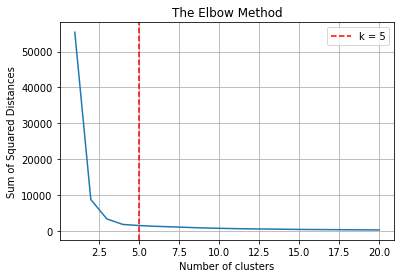

In [42]:
# @title
X = df_advert_panels_sub[["X","Y"]]
max_k = 20
## run through each iteration
model_inertias = [] 
for i in range(1, max_k+1):
    if len(X) >= i:
       model = cluster.KMeans(n_clusters=i, init='k-means++', max_iter=300, n_init=10, random_state=0)
       model.fit(X)
       #inertia: Sum of squared distances of samples to their closest cluster center.
       model_inertias.append(model.inertia_)
## choose best k based on lowest derivative
k = [i*100 for i in np.diff(model_inertias,2)].index(min([i*100 for i 
     in np.diff(model_inertias,2)]))
# Elbow plot
fig, ax = plt.subplots()
ax.plot(range(1, len(model_inertias)+1), model_inertias)
ax.axvline(k, ls='--', color="red", label="k = "+str(k))
ax.set(title='The Elbow Method', xlabel='Number of clusters', 
       ylabel="Sum of Squared Distances")
ax.legend()
ax.grid(True)
plt.show()

Based on the elbow method we can conclude that the best amount of clusters are 5. This is because of the lowest derivative/ decrease of the intertia (sum of squared distances).

In [43]:
# @title
k = 5
model = cluster.KMeans(n_clusters=k, init='k-means++',max_iter=10000, n_init=10, random_state=0)

## clustering
dtf_X = X.copy()
dtf_X["cluster"] = model.fit_predict(X)
## find real centroids
closest, distances = vq(model.cluster_centers_, 
                     dtf_X.drop("cluster", axis=1).values)
dtf_X["centroids"] = 0
for i in closest:
    dtf_X["centroids"].iloc[i] = 1
## add clustering info to the original dataset
df_advert_panels_sub[["cluster","centroids"]] = dtf_X[["cluster","centroids"]]
df_advert_panels_sub.sample(5)

/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



,PanelID,dicofre,freguesia,concelho,distrito,X,Y,Max_Visibi,Average_Da,geometry,max_vis_bins,avg_daily_views_bins,max_vis_views,cluster,centroids
23712,26883,151007,"União das freguesias do Seixal, Arrentela e Al...",Seixal,Setúbal,-9.105785,38.617515,69,5490.0,POINT (-9.10578 38.61751),69,50%,378810.0,0,0
4054,18441,111128,União das freguesias de Sintra (Santa Maria e ...,Sintra,Lisboa,-9.379972,38.775261,69,3804.0,POINT (-9.37997 38.77526),69,50%,262476.0,0,0
13489,2699,151210,"União das freguesias de Setúbal (São Julião, N...",Setúbal,Setúbal,-8.892893,38.526762,69,12530.0,POINT (-8.89289 38.52676),69,100%,864570.0,0,0
28702,32430,130620,Nogueira e Silva Escura,Maia,Porto,-8.580164,41.228652,69,3019.0,POINT (-8.58016 41.22865),69,25%,208311.0,1,0
10608,25274,110602,Alcântara,Lisboa,Lisboa,-9.176497,38.705423,69,357.0,POINT (-9.17650 38.70542),69,25%,24633.0,0,0


In [44]:
# @title
#merge df_sub geographical information based on dicofre
df_advpanels_dicofre = pd.merge(df_advert_panels_sub,df_dicofre.drop_duplicates('Dicofre'), how='left',right_on='Dicofre',left_on='dicofre')

In [45]:
# @title
centroid_name = 'Distrito'
centroids = df_advpanels_dicofre[df_advpanels_dicofre.centroids==1]
centroid_dict = centroids[['cluster',centroid_name]].set_index('cluster').to_dict()
centroid_dict

{'Distrito': {0: 'Lisboa', 1: 'Porto', 2: 'Faro', 3: 'Aveiro', 4: 'Santarém'}}

In [46]:
# @title
#set the cluster centroid location (District) as cluster name
df_advert_panels_sub['centroid_location'] = df_advert_panels_sub.cluster.apply(lambda x: centroid_dict[centroid_name][x])
df_advert_panels_clusters = df_advert_panels_sub.copy()
df_advert_panels_clusters.rename(columns={'X':'Longitude','Y':'Latitude'},inplace=True)


In [47]:
# @title
#plot clusters and centroids
fig = px.scatter(df_advert_panels_clusters,x="Longitude", y="Latitude",color="centroid_location")
fig2 = px.scatter(centroids,x="X", y="Y")
fig2.update_traces(marker=dict(size=12,
                              line=dict(width=2,
                                        color='DarkSlateGrey')),
                  selector=dict(mode='markers'))

fig.add_trace(fig2.data[0])
for i, frame in enumerate(fig.frames):
    fig.frames[i].data += (fig2.frames[i].data[0],)
fig.update_layout(title="Clusters and Centroids", width=800, height=1000)
fig.show()

In the above plot, we applied geospatial clustering algorithm which calculates clusters based on the panels' location. 
Theoretically if we increase the number of clusters to a much larger number (100) we could perform also the ads analysis and optimization for those clusters.

The 2 dimensional representation using cluster and their centroid shows nice geographical seperation. While Lisbon and Porto seem to have density of advertisment panels, for the other regions there are more spread out. To get a better understanding we create a polygon for each cluster to calculate a density measure for comparion by also taking into account average number of daily viewers and traffic based on mobility data.

In [48]:
# @title
distances = model.fit_transform(X)
variance = 0
i = 0
for label in model.labels_:
    variance = variance + distances[i][label]
    i = i + 1

cluster_centers = [X[model.labels_ == i].mean(axis=0) for i in range(k)]

clusterwise_sse = k * [0]
for point, label in zip(X.values, model.labels_):
    clusterwise_sse[label] += np.square(point - cluster_centers[label]).sum()

mean_sse = clusterwise_sse / df_advert_panels_clusters.cluster.value_counts().sort_index()
df_mean_sse = mean_sse.to_frame('mean_sse')
df_mean_sse['cluster'] = df_mean_sse.index
df_mean_sse['centroid_locations'] = df_mean_sse.cluster.apply(lambda x: centroid_dict[centroid_name][x] )

The following table shows that **Lisbon and Porto clusters have the lowest intra cluster distances** which suggest the **highest densities in comparison to the other clusters**.

In [49]:
# @title
df_mean_sse.sort_values('mean_sse')

,mean_sse,cluster,centroid_locations
0,0.020273,0,Lisboa
1,0.041734,1,Porto
2,0.121488,2,Faro
3,0.181980,3,Aveiro
4,0.257420,4,Santarém


In [50]:
# @title
df = df_advert_panels_clusters[df_advert_panels_clusters.cluster == 1]
lon_lat_df = df[['Longitude','Latitude']]
lon_lat = lon_lat_df.values

In [51]:
# @title
#a function that calculates the sum of squared distances from a centroid to all points
def mean_sse_to_centroid(lon_lat):
  centroid = np.mean(lon_lat,axis=0)
  sse = 0
  for point in lon_lat:
      sse += np.square(point - centroid).sum()
  mean_sse = sse/lon_lat.shape[0]
  return mean_sse

#pairwise distances between all points in a cluster
def mean_pairwise_dist(lon_lat):
  pairwise_dist_eucl = pairwise_distances(lon_lat)
  tril = np.tril(pairwise_dist_eucl)
  tril_vals = tril[tril > 0]
  mean_paiwise_dist = tril_vals.mean()
  return mean_paiwise_dist
  


### Models and Solutions

#### MODEL 01 - Base model based on Maximum Average Views per Dicofre

Our first model that decides which panels to keep in each dicofre by keeping the ones that have the most number of average daily views. 
We start by creating a dataframe that groups by dicofre, and sort the entries by "Average Daily View" in descending order. This will display the most viewed panels in each dicofre. Then we can apply a threshold on total view counts to decide the optimal number of panels that achieves the viewing objective.

In [52]:
#@title
df_dico_sort = df_advert_panels_sub.sort_values(['dicofre','Average_Da'],ascending=[True,False])
df_dico_sort['panel_idx'] = df_dico_sort.groupby('dicofre').cumcount()
df_dico_sort['cumsum_daily_views'] = df_dico_sort.groupby('dicofre')["Average_Da"].cumsum()
df_total_views = df_dico_sort.groupby('dicofre')["cumsum_daily_views"].max().reset_index(name='total_views')
df_pannel_counts = df_dico_sort.groupby('dicofre').size().reset_index(name='panel_counts')
df_dico_sort = df_dico_sort.merge(df_total_views, on ="dicofre")
df_dico_sort = df_dico_sort.merge(df_pannel_counts, on ="dicofre")
df_dico_sort = df_dico_sort[['dicofre', 'panel_idx', 'PanelID', 'Max_Visibi', 'Average_Da', 'panel_counts',  'cumsum_daily_views', 'total_views', 'X', 'Y', 'geometry',
       'max_vis_bins', 'avg_daily_views_bins', 'max_vis_views']]

df_dico_sort

,dicofre,panel_idx,PanelID,Max_Visibi,Average_Da,panel_counts,cumsum_daily_views,total_views,X,Y,geometry,max_vis_bins,avg_daily_views_bins,max_vis_views
0,010103,0,45202,69,507.0,6,507.0,1752.0,-8.426420,40.518970,POINT (-8.42642 40.51897),69,25%,34983.0
1,010103,1,45201,69,472.0,6,979.0,1752.0,-8.426420,40.518970,POINT (-8.42642 40.51897),69,25%,32568.0
2,010103,2,1148,69,300.0,6,1279.0,1752.0,-8.414455,40.519570,POINT (-8.41446 40.51957),69,25%,20700.0
3,010103,3,1145,69,174.0,6,1453.0,1752.0,-8.414379,40.519596,POINT (-8.41438 40.51960),69,25%,12006.0
4,010103,4,1144,69,153.0,6,1606.0,1752.0,-8.414372,40.519599,POINT (-8.41437 40.51960),69,25%,10557.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
30370,182341,114,20713,75,127.0,117,330092.0,330247.0,-7.923001,40.659194,POINT (-7.92300 40.65919),71-88,25%,9525.0
30371,182341,115,20716,75,78.0,117,330170.0,330247.0,-7.922996,40.659223,POINT (-7.92300 40.65922),71-88,25%,5850.0
30372,182341,116,20715,75,77.0,117,330247.0,330247.0,-7.922996,40.659223,POINT (-7.92300 40.65922),71-88,25%,5775.0
30373,182403,0,49302,88,1241.0,2,1241.0,1491.0,-8.232228,40.686346,POINT (-8.23223 40.68635),71-88,25%,109208.0


In [53]:
#@title
## This function returns a filtered dataframe based on "cumsum_daily_views". It will return
## all rows up until "cumsum_daily_views" first reaches or exceeds the threshold
## The input dataframe has been sorted by "dicofree" and "Average_Da"

def filter_views_by_threshold(df, threshold):
  res = []
  dic = ""
  for i, row in df.iterrows():  
    row["threshold"] =threshold
    if row["cumsum_daily_views"] < row["total_views"] * threshold:      
      res.append(row)
    else:
      if dic == row["dicofre"]:
        continue
      res.append(row)
      dic = row["dicofre"]
  return pd.DataFrame(res)

What happens when we reduce the total maximum panel views per Dicofre by 50%?

In [54]:
#@title
df_filtered = filter_views_by_threshold(df_dico_sort, 0.5)
df_filtered

,dicofre,panel_idx,PanelID,Max_Visibi,Average_Da,panel_counts,cumsum_daily_views,total_views,X,Y,geometry,max_vis_bins,avg_daily_views_bins,max_vis_views,threshold
0,010103,0,45202,69,507.0,6,507.0,1752.0,-8.426420,40.518970,POINT (-8.42642 40.51897),69,25%,34983.0,0.5
1,010103,1,45201,69,472.0,6,979.0,1752.0,-8.426420,40.518970,POINT (-8.42642 40.51897),69,25%,32568.0,0.5
6,010119,0,1142,69,3758.0,4,3758.0,13227.0,-8.430254,40.615785,POINT (-8.430254 40.615785),69,50%,259302.0,0.5
7,010119,1,1140,69,3727.0,4,7485.0,13227.0,-8.430172,40.615791,POINT (-8.430172000000001 40.615791),69,50%,257163.0,0.5
10,010121,0,29709,145,35681.0,49,35681.0,587363.0,-8.462276,40.593796,POINT (-8.462275999999999 40.593796),145,100%,5173745.0,0.5
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
30278,182341,22,20723,75,5501.0,117,154348.0,330247.0,-7.915489,40.662408,POINT (-7.915489 40.662408),71-88,50%,412575.0,0.5
30279,182341,23,20823,69,5395.0,117,159743.0,330247.0,-7.915309,40.661582,POINT (-7.915309 40.661582),69,50%,372255.0,0.5
30280,182341,24,20731,75,5195.0,117,164938.0,330247.0,-7.914898,40.658995,POINT (-7.914898 40.658995),71-88,50%,389625.0,0.5
30281,182341,25,20686,89,4945.0,117,169883.0,330247.0,-7.917465,40.666826,POINT (-7.917465 40.666826),89,50%,440105.0,0.5


In [55]:
#@title
print("This Proportion of panels: ")
print(len(df_filtered) / len(df_dico_sort))
print("creates this proportion of views: ")
sum(df_filtered.groupby("dicofre").cumsum_daily_views.max()) / sum(df_dico_sort.groupby("dicofre").cumsum_daily_views.max())

This Proportion of panels: 
0.270320987654321
creates this proportion of views: 


0.5091392900498153

It seems 27% of the panels can provide almost 51% of the total views, at a Dicofre level. This could be a way of reducing visual impact of outdoor advertising without drastically reducing the total reach of the advertisements.

In [56]:
#@title
df_steps = []

for i in range(1, 11):  
  df_steps.append(filter_views_by_threshold(df_dico_sort, i*0.1))

x = []
y = []

for _df in df_steps:
  x.append(len(_df) / len(df_dico_sort))
  y.append(sum(_df.groupby("dicofre").cumsum_daily_views.max()) / sum(df_dico_sort.groupby("dicofre").cumsum_daily_views.max()))

df_rep_dicos = pd.concat(df_steps)

## create "scaled_view" to vary size of plot point accordding to average daily view (for future visualisation)
dmin, dmax, dmean = df_rep_dicos["Average_Da"].min(), df_rep_dicos["Average_Da"].max(), df_rep_dicos["Average_Da"].mean()

df_rep_dicos["scaled_view"] = df_rep_dicos["Average_Da"].apply(lambda x: ((x - dmin + 2 ) / dmean))

df_rep_dicos1 = pd.merge(df_rep_dicos, df_dicofre_no_dup[["Dicofre",'Freguesia', 'Concelho', 'Distrito']],left_on='dicofre', right_on="Dicofre", how="left")
df_rep_dicos1 = df_rep_dicos1.rename(columns={"Freguesia" : "freguesia", "Concelho" : "concelho", "Distrito" : "distrito"})
df_rep_dicos1 = df_rep_dicos1[['dicofre','freguesia', 'concelho', 'distrito','panel_idx', 'PanelID', 'Max_Visibi', 'Average_Da',
       'panel_counts', 'cumsum_daily_views', 'total_views', 'X', 'Y',
       'geometry', 'max_vis_bins', 'avg_daily_views_bins', 'max_vis_views',
       'threshold', 'scaled_view']]     

## reverse dataframe order for plotting purpose
df_rep_dicos = df_rep_dicos1
df_rep_dicos_rev = df_rep_dicos.sort_values(by=["dicofre", "threshold"], ascending=[True, False])
df_rep_dicos.head()

,dicofre,freguesia,concelho,distrito,panel_idx,PanelID,Max_Visibi,Average_Da,panel_counts,cumsum_daily_views,total_views,X,Y,geometry,max_vis_bins,avg_daily_views_bins,max_vis_views,threshold,scaled_view
0,010103,Aguada de Cima,Águeda,Aveiro,0,45202,69,507.0,6,507.0,1752.0,-8.426420,40.518970,POINT (-8.42642 40.51897),69,25%,34983.0,0.1,0.044717
1,010119,Valongo do Vouga,Águeda,Aveiro,0,1142,69,3758.0,4,3758.0,13227.0,-8.430254,40.615785,POINT (-8.430254 40.615785),69,50%,259302.0,0.1,0.348849
2,010121,União das freguesias de Águeda e Borralha,Águeda,Aveiro,0,29709,145,35681.0,49,35681.0,587363.0,-8.462276,40.593796,POINT (-8.462275999999999 40.593796),145,100%,5173745.0,0.1,3.335256
3,010121,União das freguesias de Águeda e Borralha,Águeda,Aveiro,1,1168,78,28003.0,49,63684.0,587363.0,-8.443553,40.571754,POINT (-8.443553 40.571754),71-88,100%,2184234.0,0.1,2.616977
4,010122,União das freguesias de Barrô e Aguada de Baixo,Águeda,Aveiro,0,49232,88,33147.0,2,33147.0,65271.0,-8.448760,40.528228,POINT (-8.44876 40.528228),71-88,100%,2916936.0,0.1,3.098199


##### Proportion of Reduction of Views vs Panel Counts

This is at a Dicofre level, ie. we keep "y" proportion of total views at each dicofre

In [57]:
#@title
fig = px.line(x=x, y=y)
fig.update_traces(mode='markers+lines')
fig.update_layout( width=600, height=400,title_x = 0.1, 
                  xaxis_title = "proportion of total panels",
                  yaxis_title="proportion of total views",
                  title_text=f"Proportion of Total Daily Panel Views vs Total Numbers of Panels")
fig.show()

The above graph shows we can choose how to reduce the number of advertising panels in each dicofre while minimising the loss of total daily views, as long as we keep panels with the most views in each dicofre

##### Geolocation Map - Visualising Reduction of Panels

Here we can compare the results of reducing the total number of panel views in each Dicofre, by using df_steps, and see which kind of panels remain, as well as their locations. 

For instance, if we want to retain 50% of total views, then panels with less average daily views (colored in blue and red) are removed, especially in the city areas.

The animations below illustrate the difference in panel inclusions based on change in total daily views thresholds. By changing the threshold from 1 to 0.1 in steps of 0.1, we can see which panels get dropped, their location, and characteristics such as their average daily view, or maximum visibile distance.

In [58]:
#@title
print("Location of panels with various daily views thresholds -    size: proportional to average daily views    color: ave daily views quantiles")
#fig = px.scatter_mapbox(df_rep_dicos, animation_frame="threshold", lat="Y", lon="X", width=700, height=800,center={'lon':-8.473975,'lat':39.900768},zoom=6,color="Max_Visibi")#,hover_data='PanelID')#,size="Max_Visibi")
fig = px.scatter_mapbox(df_rep_dicos_rev, animation_frame="threshold", lat="Y", lon="X", width=1200, height=800,  size= "scaled_view", center={'lon':-9.1500,'lat':38.7218},zoom=13, color="avg_daily_views_bins")#,hover_data='PanelID')#,size="Max_Visibi")
fig.update_layout(mapbox_style="carto-positron")
fig.update_layout(margin={"r":0,"t":0,"l":0,"b":0})
fig.layout.updatemenus[0].buttons[0].args[1]['frame']['duration'] = 1500
fig.layout.updatemenus[0].buttons[0].args[1]['transition']['duration'] = 1500
fig.show()

Location of panels with various daily views thresholds -    size: proportional to average daily views    color: ave daily views quantiles


In [59]:
#@title
print("Location of panels with various daily views thresholds -    size: proportional to average daily views    color: max visibility")
fig = px.scatter_mapbox(df_rep_dicos_rev, animation_frame="threshold", lat="Y", lon="X", width=1200, height=800,  size= "scaled_view", center={'lon':-9.1500,'lat':38.7218},zoom=13, color="Max_Visibi")#,hover_data='PanelID')#,size="Max_Visibi")
fig.update_layout(mapbox_style="carto-positron")
fig.update_layout(margin={"r":0,"t":0,"l":0,"b":0})
fig.layout.updatemenus[0].buttons[0].args[1]['frame']['duration'] = 1500
fig.layout.updatemenus[0].buttons[0].args[1]['transition']['duration'] = 1500
fig.show()

Location of panels with various daily views thresholds -    size: proportional to average daily views    color: max visibility


#### MODEL 02 - spread out the location of panels

Our second model aimed to spread out the location of panels in each “dicofre”, by identifying the top panels and use the proximity of surrounding panels and their maximum value of daily views to decide which panels to keep.

**Algorithm to choose best panelid**

1. The algorithm sort whole input according to the max daily views * max visibility

2. The algorithm apply for each dicofre seperatly

3. Choose the the biggest max daily views * max visibility panel to keep in the system and put it into a list of panels to keep

4. Sort the remaining panels by max daily views * max visibility

5. If the distance is greater than a threshold for almost all the points in the list (90%), then we include the first panel in the list, otherwise we drop the panel.

6. Repeat for all the remaining panels


In [60]:
#@title
#Euclidian distance function
def dist(x1,y1,x2,y2):
  return np.sqrt((x1-x2)**2+(y1-y2)**2)

#The distance function between two points with  longitude and latitude on the earth
def dist1(x1,y1,x2,y2):
# approximate radius of earth in km
    R = 6373000
    lat1 = radians(x1)
    lon1 = radians(y1)
    lat2 = radians(x2)
    lon2 = radians(y2)

    dlon = lon2 - lon1
    dlat = lat2 - lat1

    a = sin(dlat/ 2)**2 + cos(lat1) * cos(lat2) * sin(dlon/ 2)**2
    c = 2 * atan2(sqrt(a), sqrt(1 - a))
    distance = R * c
    return distance

def choose_best_panelid_by_distance(df_,treshold_=0.00001):
    array_df= np.array(df_[['PanelID','X','Y','Max_Visibi','Average_Da','geometry','dicofre','max_vis_views']])
    list_panelid = [array_df[0]]
    list_droped_panelid = []
    if len(array_df) > 1:
        for i in range(1, len(array_df)):
            sum = 0
            for j in range(0,len(list_panelid)):
               if dist1(array_df[j][1],array_df[j][2],array_df[i][1],array_df[i][2])>treshold_:
                  sum+=1
               else:
                  sum = 0
            if sum >= i-2:
               list_panelid.append(array_df[i])
            else:
               list_droped_panelid.append(array_df[i])
    else:
        pass
    return list_panelid,list_droped_panelid

#Function
#The final dataframe with the best choice of the panelIDs
def final_df_with_best_choice_of_panelID(df_):
    df_sort = df_.sort_values('max_vis_views',ascending = False)
    df_sort= df_sort.dropna()
    list_df_remain = [] 
    list_df_drop = []
    
    dicofre_unique = list(df_sort.dicofre.unique())
    #dicofre_unique = ['110654','110657','130812']
    for dicofre in dicofre_unique:
        df_sort_by_dicofre  = df_sort.loc[df_sort.dicofre==dicofre,:]
        list_panelid,list_droped_panelid = choose_best_panelid_by_distance(df_sort_by_dicofre,0.00001)
        df_remain = pd. DataFrame(list_panelid, columns=['PanelID','X','Y','Max_Visibi','Average_Da','geometry','dicofre','max_vis_views'])
        df_drop = pd. DataFrame(list_droped_panelid, columns=['PanelID','X','Y','Max_Visibi','Average_Da','geometry','dicofre','max_vis_views'])
        list_df_remain.append(df_remain)
        list_df_drop.append(df_drop)
    df_final_remain = pd.concat(list_df_remain)
    df_final_remain['remain_drop'] = 'remain'
    df_final_drop = pd.concat(list_df_drop)
    df_final_drop['remain_drop'] = 'drop'
    df_total = df_final_remain.append(df_final_drop)
    return df_final_remain,df_final_drop ,df_total


##### Apply the functions

In [61]:
#@title
df_final_remain,df_final_drop,df_total = final_df_with_best_choice_of_panelID(df_advert_panels_sub)

In [62]:
# @title
fig = px.scatter_mapbox(df_total, lat="Y", lon="X", width=700, height=800,center={'lon':-8.473975,'lat':39.900768},zoom=6,color="remain_drop",size="Average_Da",color_discrete_sequence=["green", "black"])#, hover_data='PanelID' )#,size="Max_Visibi")
fig.update_layout(mapbox_style="carto-positron")
fig.update_layout(margin={"r":0,"t":0,"l":0,"b":0})
fig.show()

In [63]:
#@title
print('The algorithm keeps about {} panelids.'.format(df_final_remain.shape[0]))
print('The algorithm drop about {} panelids'.format(df_final_drop.shape[0]))
print('The total daily average view before droping panelids are : {}'.format(df_total.Average_Da.sum()))
print('The average daily view of remaining panelIDs are : {}'.format(df_total.loc[df_total.remain_drop=='remain','Average_Da'].sum()))
print('The average daily view of dropping panelIDs are : {}'.format(df_total.loc[df_total.remain_drop=='drop','Average_Da'].sum()))
print('In total by the above algorithm it remains  about {} % of the total daily view.'.format(100*df_total.loc[df_total.remain_drop=='remain','Average_Da'].sum()/(df_total.Average_Da.sum())))
print("The above value can change according to the treshold of the distance between panelids.")
print('In total we drop about {} % of the total panelids.'.format(df_total.loc[df_total.remain_drop=='drop',:].shape[0]*100/df_total.shape[0]))

The algorithm keeps about 17596 panelids.
The algorithm drop about 12779 panelids
The total daily average view before droping panelids are : 221807929.16666
The average daily view of remaining panelIDs are : 158859609.749996
The average daily view of dropping panelIDs are : 62948319.416664004
In total by the above algorithm it remains  about 71.62034754430873 % of the total daily view.
The above value can change according to the treshold of the distance between panelids.
In total we drop about 42.07078189300412 % of the total panelids.


#### MODEL 03 - Genetic Algorithm

Finally, we found that Genetic Algorithm provides an elegant way to solve this problem, as it provides a great level of controls in designing what criteria to optimize for, by creating customised "fitness function", and selecting the number of iterations and other parameters. We can experiment with the model until we are happy with the results.

##### Methodology

Genetic Algorithms have been used for many different optimisation problems for machine learning algorithms, such as optimising the hyperparameters of neural networks (Kopel, 2012), feature extraction (Pei, Goodman, Punch, & Ding) or for classification of flower plants (Kadhum, 2009).**Genetic Algorithms are used as optimization methods based on the foundations of natural selection and genetics**. They are methods that search for an optimal solution in a usual large space of solutions, but they do not need an intensive analysis of the search space as they start with random solutions and improve them iteratively. The solutions in this sense also referred to as individuals and are strings of characters of prefixed length (Vanneschi, 2018). 

A **solution or individual is presented as 𝑔=[p1,p2,...,pi,...pq-1,pq], p𝑖∈{0,1} p stand for 𝑖𝑡ℎ panel from all panels(in cluster or group)** that are generated randomly and 𝑞 is the initial number of panels. Basically, **a solution (individual) is a set of panels that we want to keep**. The elimination of a certain panel works when 𝑔𝑖 is set to zero. The number of omitted panels equals the number of zeros in the solution 𝑔.


In each generation we calculate the fitness of each **individual (one solution)** in the **set of solutions (population)**. High mutation and crossover probabilitie change indivuald at each generation to introduce more diverse individuals. This is possible because as we keep the best individual (elitism) at each generation.

At the end, **we choose the best individual (set of panels) that optimise the problem according to our custom fitness function**.



Kopel, A. (2012). Neural Networks Performance and Structure Optimization Using Genetic Algorithms (Master of Science in Electrical Engineering). California Polytechnic State University, San Luis Obispo.

Kadhum, M. A. (2009). Using Genetic Algorithm for classification of flower plants. AL-Qadisiyia University-College of Science, Sharjah. Retrieved from https://www.iasj.net/iasj?func=fulltext&aId=42321

Vanneschi, L. (2018). Genetic Programming: Introduction, Motivations and Applications. Lisbon.)

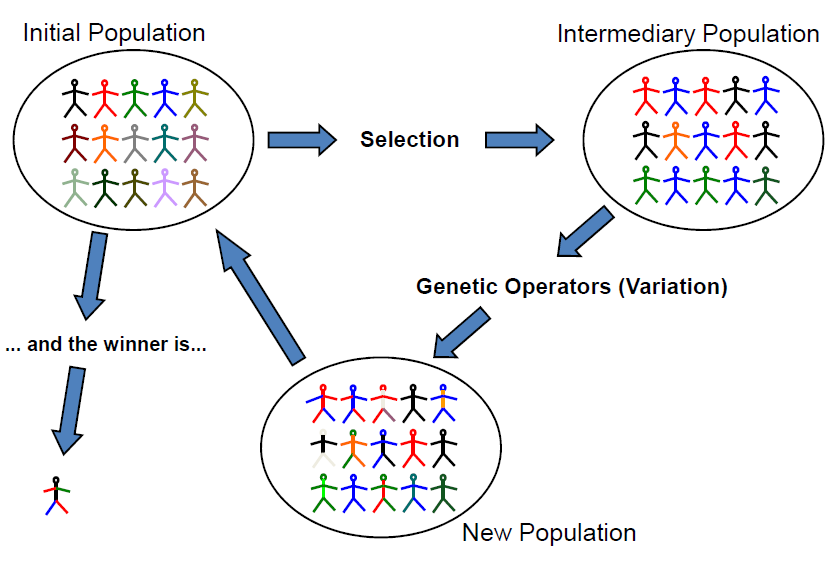

Figure: Evolutionary algorithms - iterative workflow (Vanneschi, 2018)


##### Fitness Function

*The fitness function simply defined is a function which takes a candidate solution to the problem as input and produces as output how “fit” or how “good” the solution is with respect to the problem in consideration.*[Fitness Function](https://www.tutorialspoint.com/genetic_algorithms/genetic_algorithms_fitness_function.htm)

To create a suitable fitness function we need to understand what we are trying to achieve by minimising visual pollution, but keeping things like average daily views high. Having high density panel areas suggest that could have high number of average daily views but this views seem to be likely from the same people rather than from different people. This raises a problem as humans can only take as much information. Having many panels in one place might be inefficient. Therefore we suggest that **panels should be more spread out and be less dense**. We want to **maintain high daily views** but as the we reduce the panels in denser areas and keep panels in more spread areas we might be able to reach our target audience beteter as they will feel less overwhelmed by the amount of panels and information.Here we also think its important to **reduce the number of larger panels to reduce visual pollution**. Here we want to keep small panels with high avg views and omit large panels with low avg daily views. This keypoints and other consideration create the base for the fitness function.

The fitness function incooperates various elements to find the best solution by minizing the fitness value. The main elements based on our assumptions above are:

* mean_sse_keep: the spread or distances between points to be maximised to avoid high density areas of panels
* mean_sse_omit: for omitted panels we want to maximise the pairwise distances to avoid omitting many panels in a certain area
* mean_max_vis: assuming that maximum visibilit of a panel correlates to size, we waant minimise the visual pollution by omitting larger panels
* mean_avgview: maximising the average numnber of views
* min_size_penalty: build in treshold that can be userdefined proportion of panels to keep (+/- 3% to have more variability in the solution), if a solution doesnt meet this criteria a high penalty of 99999999 (can be any large number) is added
* min_avgview_penalty: based on proportion of panels to keep the average number of viewers overall shouldnt be lower than the panels omitted, this is to prevent to omit high daily viewer panels and avoid imbalance between omitted panels and avg daily viewers. 

As this is handled minimisation problem, we introduce negative logs:
 **fitness = - 0.1 * np.log(mean_sse_keep) - 0.1 * np.log(mean_sse_omit) - 0.1 * np.log(mean_max_vis) - 0.7 * np.log(mean_avgview) + min_size_penalty + min_avgview_penalty**

 to calculate the fitness we normalised all input values and applied weighting to achieve overall best results. **The fitness function can be defined to the business needs to get best possible solution.**


In [64]:
# @title

class Individual:
    
    def __init__(self, IndSize, fit_vals, vals, keep_prop):
        self.individual = None
        self.fitness = 0
        self.IndSize = IndSize
        self.fit_vals = fit_vals
        self.vals = vals
        self.keep_prop = keep_prop
        self.Individual()
        self.Fitness()
        
        #self.create_i2h()
        
    def Individual(self):
        #self.individual = np.random.randint(2,size=self.IndSize)
        prob = self.keep_prop #np.random.uniform(0,1)
        self.individual = np.random.choice(2, size=self.IndSize, p=[1-prob,prob])
    
    #pairwise distances between all points in a cluster
    def mean_pairwise_dist_eucl(self, lon_lat):
        pairwise_dist_eucl = pairwise_distances(lon_lat)
        tril = np.tril(pairwise_dist_eucl)
        tril_vals = tril[tril > 0]
        mean_paiwise_dist = tril_vals.mean()
        return mean_paiwise_dist

    def mean_pairwise_dist_haversine(self, lon_lat):
        pairwise_dist_eucl = haversine_distances(lon_lat)
        tril = np.tril(pairwise_dist_eucl)
        tril_vals = tril[tril > 0]
        mean_paiwise_dist = tril_vals.mean()
        return mean_paiwise_dist

    def Fitness(self):
        #addconstant to avoid log divide by 0 error
        add_constant = 0.000000001

        #mean sse for points to keep
        bool_arr = self.individual>0
        mean_sse_keep = self.mean_pairwise_dist_eucl(self.fit_vals[:,:2][bool_arr]) + add_constant #maximise this

        #have smaller size panels Max_Visibi
        mean_max_vis = np.square(self.fit_vals[:,2][bool_arr].mean()) + add_constant

        #highest views Average_Da
        keep_avgviews = self.fit_vals[:,3][bool_arr]
        keep_avgviews_v = self.vals[:,3][bool_arr]
        mean_avgview = np.square(keep_avgviews.mean()) + add_constant

        #also omitted points to have max mean sse
        bool_arr = self.individual==0
        mean_sse_omit = self.mean_pairwise_dist_eucl(self.fit_vals[:,:2][bool_arr]) + add_constant

        #if less than treshold high penalty betwen +/-3%
        min_size_penalty = 0 if (self.individual.sum() > (self.IndSize * (self.keep_prop-0.03))) & (self.individual.sum() < (self.IndSize * self.keep_prop+0.03))  else 99999999

        #minimum views to keep
        min_keep_avgviews_bool = keep_avgviews_v.sum() >= (self.vals[:,3].sum() * (self.keep_prop+0.01))
        min_avgview_penalty = 0 if min_keep_avgviews_bool  else 99999999

        #take neg log for minimizsation
        self.fitness = -0.1*np.log(mean_sse_keep) - 0.1*np.log(mean_sse_omit) + 0.1*np.log(mean_max_vis) - 0.7* np.log(mean_avgview) + min_size_penalty + min_avgview_penalty 
        
        #self.fitness = - np.log(mean_sse_keep) - np.log(mean_sse_omit) + min_size_penalty + min_avgview_penalty 

        return self.fitness

class GeneticAlgorithm:
    
    def __init__(self, pxo, pm, IndSize, populationSize, Gens):
        self.IndSize = IndSize #ho long is the array, defined by the number of hidden neurons
        self.populationSize = populationSize #How many individuals
        self.population = {}
        self.fitnesses = {}
        self.OffspringFitnesses = {}
        self.results = {}
        self.bestInd_byGen = {}
        self.tournamentSize = 2  #max is population size
        self.Gens = Gens
        self.pxo = pxo
        self.pm = pm
        self.bestIndividual = None
        self.bestOffspring = None
        self.offsprings = []
        self.parent1 = None
        self.parent2 = None
    
    def search(self):
        #self.init_Population()
       # best = self.BestIndividual(self.population)
        print('Show Fitness for every 10th Generation')
        for gen in range(self.Gens):
            
            self.offsprings = []
            for i in range(self.populationSize):
            
                p1 = self.TournamentSelection()
                p2 = self.TournamentSelection()
                
                self.offspring = deepcopy(self.population[p1])
                
                if (random() <= self.pxo):
                    self.OnePointCrossover(p1,p2)
                    
                if (random() <= self.pm):
                    self.standardMutation()
                    
                self.offsprings.append(self.offspring)
                
                for i in range(len(self.offsprings)):
                    self.offsprings[i].Fitness()
                
            self.replacement()
            bestInd = self.BestIndividual(self.population)
            self.results[gen] = bestInd.fitness
            if (gen % 10) == 0:
              print('Generation:',gen)
              print('Fitness:',bestInd.fitness)
            if (gen % 50) == 0:
              self.bestInd_byGen[gen] = bestInd.individual
        plt.plot(list(self.results.keys()),list(self.results.values()))
        plt.title('Fitness by Generation')
        plt.xlabel('Generation')
        plt.ylabel('Fitness')

    def init_Population(self,fit_vals,vals,keep_prop):
        
        #i2h =  np.random.uniform(-1,1,(self.feat,self.IndSize))#create input weight matrix randomly
        for x in range(0,self.populationSize):
            self.population[x] = Individual(self.IndSize, fit_vals,vals,keep_prop)
        return self.population

            
    ##Selection
    ###RouletteWheel for maximization problem
    def TournamentSelection(self):
        parentIndex = randint(0,self.populationSize-1)
        for i in range(0,self.tournamentSize):
            temp = randint(0,self.populationSize-1)
            if (self.population[parentIndex].fitness> self.population[temp].fitness):
                parentIndex = temp
        return parentIndex
            
    ##Crossover
    def OnePointCrossover(self, p1Idx,p2Idx):
        
        #print('CROSSOVER1  ' + str(self.population))
        p2 = deepcopy(self.population[p2Idx])

        XOPoint = randint(0,self.IndSize)
        offspr = deepcopy(self.population[p1Idx])
        for i in range(XOPoint, self.IndSize):
            
            offspr.individual[i] = p2.individual[i]
            
        self.offspring = deepcopy(offspr)
        return self.offspring
        
    #Mutation
    def standardMutation(self):
        r = randint(0,self.IndSize-1)
        #print(r)
        #print(offs)
        #print('MUTATION1  ' + str(self.population))
        if (self.offspring.individual[r] == 0):
            self.offspring.individual[r] = 1            
        else:
            self.offspring.individual[r] = 0
                     
        #print (offspring)
        
        #print('MUTATION2  ' + str(self.population))
        return self.offspring
    
    def BestIndividual(self, inds):
        self.inds = inds
        b = deepcopy(self.inds[0])

        for i in range(self.populationSize):
            if b.fitness > self.inds[i].fitness:
                b = deepcopy(self.inds[i])
        return b
    

    #replacment with Elitism, keep best individual
    def replacement(self):
        
        self.getBest = self.BestIndividual(self.population)
        getBestOffspring = self.BestIndividual(self.offsprings)
        
        newPopulation = {}
        newPopulation[0] = deepcopy(self.getBest)
        newPopulation[1] = deepcopy(getBestOffspring)
                     
        #print(newPopulation[0])        
        for i in range(2,len(self.offsprings)):
            newPopulation[i] = deepcopy(self.offsprings[i])
        
        self.population = deepcopy(newPopulation)
        #print(self.population)
        
        return self.population

For our test example we chose an area in the city of lisbon with a high density if advertising panels to apply the GA to reduce the number of panels and size and keep at least avg daily views equal to the proportion of panels, but ideally higher that the proporion of panels omitted (e.g keep 70% (+/- 3%) of panels but maintain >= 70% (+/- 3%) of avg daily viewers)

In [66]:
# @title
lisbon_centre_dicofre_df = df_advert_panels_clusters[df_advert_panels_clusters.centroid_location=='Lisboa'].dicofre.value_counts()
#display(lisbon_centre_dicofre_df.iloc[:5])
lisbon_centre_dicofre = list(lisbon_centre_dicofre_df.index[:1])
#lisbon_centre_dicofre = ['110602','110607','110608','110610','110621','110659','110660','110661','110662','110663','110664','110665','110666','110667','110657','110655','110656']
#lisbon_centre_dicofre = ['110654','110657','110655','110656']
lisbon_centre_dicofre = ['110655','110656']
test_df = df_advert_panels_clusters[df_advert_panels_clusters.dicofre.isin(lisbon_centre_dicofre)]
vals = test_df[['Longitude','Latitude','Max_Visibi','Average_Da']].values
scaler = MinMaxScaler()
vals_scaled = scaler.fit_transform(vals)
print('Test Area contains',test_df.shape[0], 'Panels')

Test Area contains 652 Panels


##### Running GA and Analysing the Results

Show Fitness for every 10th Generation
Generation: 0
Fitness: 1.668122517267566
Generation: 10
Fitness: 1.6570574956031288
Generation: 20
Fitness: 1.639932264812566
Generation: 30
Fitness: 1.6306642634590358
Generation: 40
Fitness: 1.6217368679325774
Generation: 50
Fitness: 1.611594393403459
Generation: 60
Fitness: 1.6055824027396177
Generation: 70
Fitness: 1.5932297809147027
Generation: 80
Fitness: 1.5869284900558518
Generation: 90
Fitness: 1.57645169768198
Generation: 100
Fitness: 1.5744937413416076
Generation: 110
Fitness: 1.5713742783919749
Generation: 120
Fitness: 1.5676934594277105
Generation: 130
Fitness: 1.5648664348152828
Generation: 140
Fitness: 1.5595528169293378
Generation: 150
Fitness: 1.5517411816190432
Generation: 160
Fitness: 1.5492974265003865
Generation: 170
Fitness: 1.545876465481044
Generation: 180
Fitness: 1.5445170460364883
Generation: 190
Fitness: 1.539313429341294
Generation: 200
Fitness: 1.5380875009756485
Generation: 210
Fitness: 1.5279768559692102
Generation:

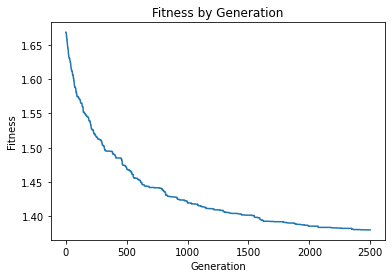

In [67]:
# GA parameters
prob_xo = 0.90
prob_mut = 0.90
individualsize = test_df.shape[0]
populationsize = 4
generations = 2500

#solution parameters
prop_panels_to_keep = 0.70

GA = GeneticAlgorithm(prob_xo,prob_mut,individualsize,populationsize,generations)
GA.init_Population(vals_scaled,vals, prop_panels_to_keep)
#first population to be fitness without penalty
while GA.BestIndividual(GA.population).fitness > 9999999:
  GA.init_Population(vals_scaled,vals, prop_panels_to_keep)
GA.search()

In [68]:
# @title
bestsolutions = GA.bestInd_byGen
test_df_1 = test_df.copy()
df_ls =[]
for k, v in bestsolutions.items():
  test_df_1 = test_df.copy()
  test_df_1['generation'] = k
  test_df_1['points_to_keep'] = v
  df_ls.append(test_df_1)
test_df_bygen = pd.concat(df_ls)
test_df_bygen['points_to_keep'] = test_df_bygen['points_to_keep'].apply(lambda x: 'keep' if x == 1 else 'omit')

test_df['points_to_keep'] = GA.getBest.individual
test_df['points_to_keep'] = test_df['points_to_keep'].apply(lambda x: 'keep' if x == 1 else 'omit')
test_df = test_df.sort_values('points_to_keep')
test_df_gb = test_df.groupby('points_to_keep').agg({'Max_Visibi':np.sum,'Average_Da':np.sum, 'PanelID':np.count_nonzero}).round(2)
display(test_df_gb)
display(test_df_gb/test_df_gb.sum())

/usr/local/lib/python3.7/dist-packages/geopandas/geodataframe.py:1322: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



,Max_Visibi,Average_Da,PanelID
points_to_keep,,,
keep,30731,4524349.5,437
omit,15233,945213.0,215


,Max_Visibi,Average_Da,PanelID
points_to_keep,,,
keep,0.668588,0.827187,0.670245
omit,0.331412,0.172813,0.329755


The table above is to check that the minimum criterias for our solution were met. Max visibility (size) of panel: the proportion of size we keep vs omit. Average Daily views: the proprtion of daily views we keep vs omit. PanelID shows the proportion of panels the solution keeps and omits. The proportion of keep for Average Daily should be equal or higher than the PanelID and max visibility (size) to be equal or smaller than PanelID proportions. Then the solution is line with the definded fitness function.

###### Visualising Reduction of Panels

The following map shows the evolution of the solution using Genetic Algorithm.With increasing generations the solutions gets better according to the defined fitness function.This is just an e

In [69]:
# @title
center = {'lon':test_df.Longitude.mean(),'lat':test_df.Latitude.mean()}
test_df_bygen.sort_values(by=["generation",'points_to_keep'],inplace=True)
fig = px.scatter_mapbox(test_df_bygen, lat="Latitude", lon="Longitude", width=700, height=800,center=center,zoom=12.75,color="points_to_keep",
                        color_discrete_sequence=["green", "black"], size="Average_Da",
                         animation_frame="generation")#, hover_data='PanelID' )#,size="Max_Visibi")
fig.update_layout(mapbox_style="carto-positron")
fig.update_layout(margin={"r":0,"t":0,"l":0,"b":0})
fig.show()

The following table shows how the proportions max visibility, average daily views and panels change with increasing generations.

In [70]:
# @title
test_df_bygen_gb = test_df_bygen.groupby(['generation','points_to_keep']).agg({'Max_Visibi':np.sum,'Average_Da':np.sum, 'PanelID':np.count_nonzero}).round(2)
test_df_bygen_gb_prop = test_df_bygen_gb/test_df_gb.sum()
test_df_bygen_gb_prop.reset_index(inplace=True)
test_df_bygen_gb_prop[test_df_bygen_gb_prop.points_to_keep == 'keep']

,generation,points_to_keep,Max_Visibi,Average_Da,PanelID
0,0,keep,0.698938,0.715225,0.697853
2,50,keep,0.671765,0.713107,0.671779
4,100,keep,0.670133,0.729312,0.670245
6,150,keep,0.669698,0.739758,0.670245
8,200,keep,0.669698,0.746537,0.670245
10,250,keep,0.670568,0.758750,0.670245
12,300,keep,0.670568,0.764138,0.670245
14,350,keep,0.670568,0.769128,0.670245
16,400,keep,0.670568,0.771623,0.670245
18,450,keep,0.670568,0.774212,0.670245


In [71]:
# @title
fig = px.scatter_mapbox(test_df, lat="Latitude", lon="Longitude", width=700, height=800,center=center,zoom=13,color="points_to_keep",
                        color_discrete_sequence=["green", "black"])#, hover_data='PanelID' )#,size="Max_Visibi")
fig.update_layout(mapbox_style="carto-positron")
fig.update_layout(margin={"r":0,"t":0,"l":0,"b":0})
fig.show()

## Conclusions

### Scalability and Impact
Tell us how applicable and scalable your solution is if you were to implement it in a city. Identify possible limitations and measure the potential social impact of your solution.

We proposed 3 separate methods for selecting the optimal advertising panels for each parish in Portugal after detailed analysis of advertising panels at the Dicofre (Parish) level. The ideas made use of each panel´s average daily view, maximum viewing distance and its proximity to other panels. 

While method 1 (selecting based on daily view) is the simplest, method 3 (Genetic Algorithm) is the most advanced, and flexible, allowing us to incorporate other criteria into the fitness function used for panel selection in the future, such as advertising revenue.

We used animation to illustrate the panel selection process, as we believe it would communicate the solution more effectively to a broader audience.

We would like to conduct a survey before and after the ad panel reduction process, to ensure that the residents are happy with the changes.


### Green Advertising Ideas

*In the summer of 2011, Coca-Cola and World Wide Fund for Nature Philippines partnered to install a 60’ x 60’ billboard using Fukien tea plants as the primary building material. The carbon dioxide-absorbing plants were vertically planted in recycled Coca-Cola bottles and watered by using a drip irrigation system.*[Living Walls in Advertising](http://buildipedia.com/aec-pros/design-news/living-walls-in-advertising)

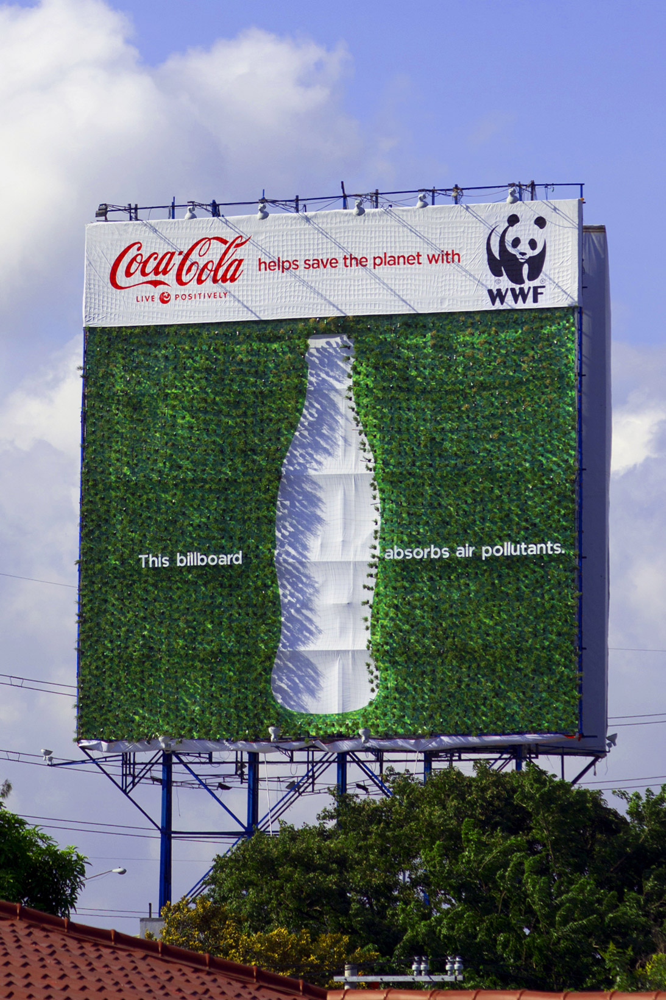

Source: [Triple Pundit: adidas Is A Green Brand But No One Knows It](https://www.pinterest.co.uk/pin/316940892503883203/)

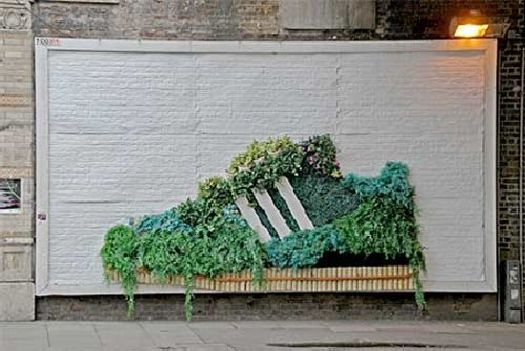

### Trash bins for advertisements
As discussed in the round table of the opening of stage 4 with Stefaan G. Verhulst and Miguel Castro Neto, why not use bin trash for advertisements and then also reduce the visual pollution caused by them?

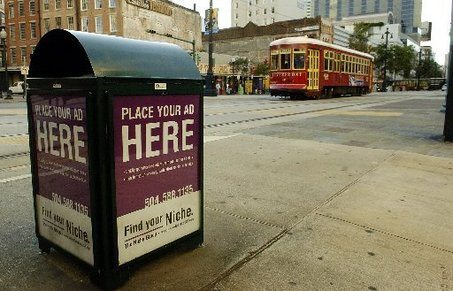



### Future Work
Now picture the following scenario: imagine you could have access to any type of data that could help you solve this challenge even better. What would that data be and how would it improve your solution? 🚀

This is a fascinating issue and we had many ideas that would be interesting to explore in the future, such as:
 
* Incorporate zone information and come up with different recommendation for residential, commercial and industrial zones
* Using green area data, penalize the panels locations close by
* Obtain advertising costs for each panel and incorporate that into modeling. Some information on the cost of the different advertising panels such as whether they may vary based on location, "maximum visibility in meters" or "average daily view". It could inform our decision on how to optimize the selection of panels, both to minimise the reduction in views, as well as reducing the loss of advertising income
* Obtain social-demographic data per parish such as population, median/ average income and report findings
* Based on street level data we could have a normalised density measure by street (taking into account length of street) to see which streets are visually most polluted
* Assuming that the majority of advertising panels are at bus shelters (due to the constant average viewing distance), perhaps a solution could be to only allow advertising at every 2nd or 3rd shelter in a street, to prevent people in a single commute being bombarded with ads while looking out the window
* Some more information about the data would be useful to have a better context: 1. Which time period does the data consider? 2. How are the daily views/max visibility in meters calculated/collected? 3. Why doesn’t max visibility vary as expected?
* Have the panel display directions to better understand their effective locations
* Currently the algorithm doesn't consider two sided panel, if two panels are located on the same location, further works could explore which side is the most effective
* Based on our experience living in Lisbon, we were surprised that the big lightful advertisement outside the Saldanha metro was not included in the data (or the max visibility in meters is wrong)
* Not sure if it is better to have more panels with smaller size or less panels but with bigger size
* Would be useful to have info about the type of panel/advertisement
* Also, we are assuming that the ads in this case is paper based, but in the future it seems that the ads are moving to the digital format that perhaps it is better in terms of flexibility and usage changes